## IGO17131_IGO17186 - KP R26-mTmG; Hopx-MACD mice exposed to Tamoxifen and harvested at 3d or 14d
Combines lanes

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib as plt

from pathlib import Path
import anndata
from joblib import dump, load

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [153]:
results_file = 'write/IGO17131_17186.h5ad'  # the file that will store the analysis results

In [5]:
adata1 = anndata.read('../IGO17131/write/allmice-tumor-IGO17131.h5ad')
adata2 = anndata.read('../IGO17186/write/allmice-tumor-IGO17186.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [6]:
adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/2331359869.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata = adata1.concatenate(adata2, join='inner', batch_categories=['First', 'Second'])


## Set highly variable genes

In [7]:
sc.pp.highly_variable_genes(adata, batch_key='batch')

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


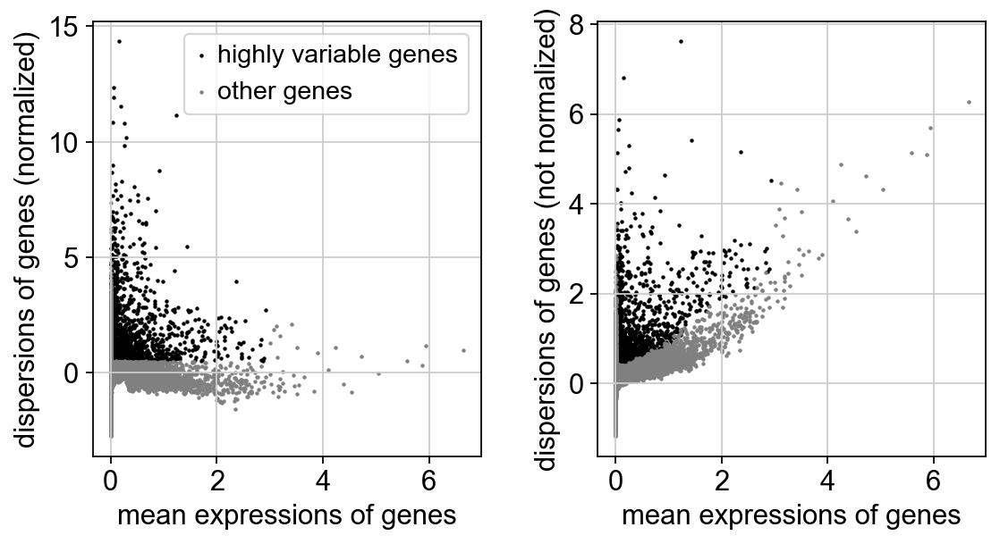

In [8]:
sc.pl.highly_variable_genes(adata)

In [9]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['CLuc'] = False
adata.var.highly_variable['GLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/2833403168.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/283340

In [10]:
adata.raw = adata

In [11]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [12]:
adata.write('write/allmice-IGO17131_IGO17186_combined.h5ad', compression='gzip')

## Principal component analysis

In [13]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:03)


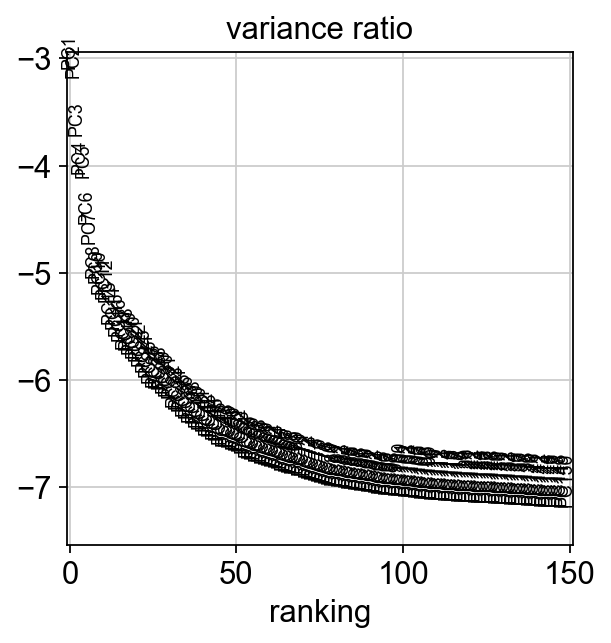

In [14]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

## Computing the neighborhood graph

In [15]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)


## Embedding the neighborhood graph

In [16]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)


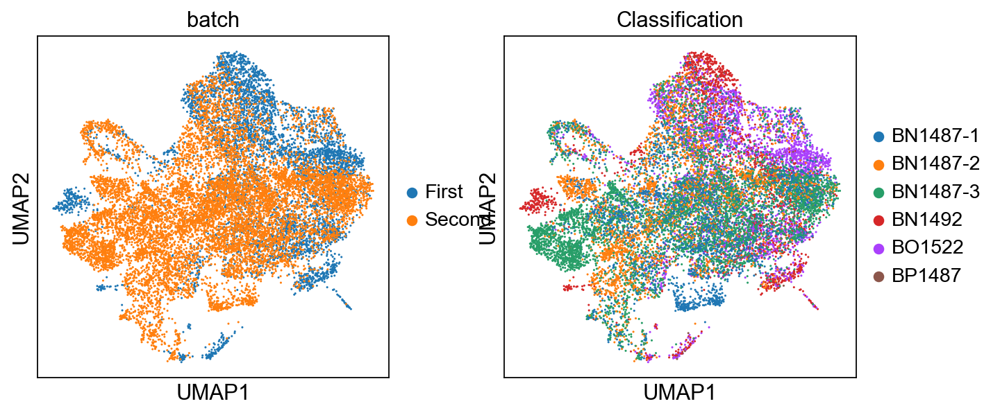

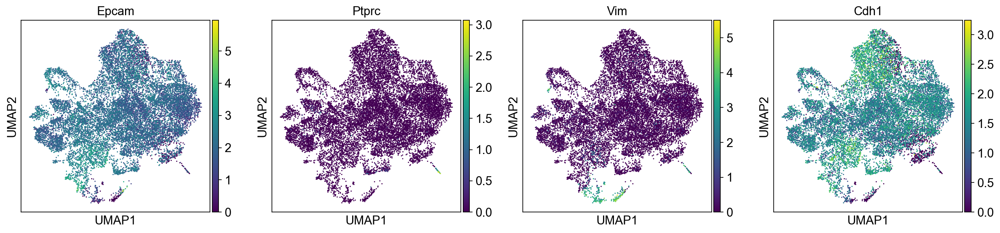

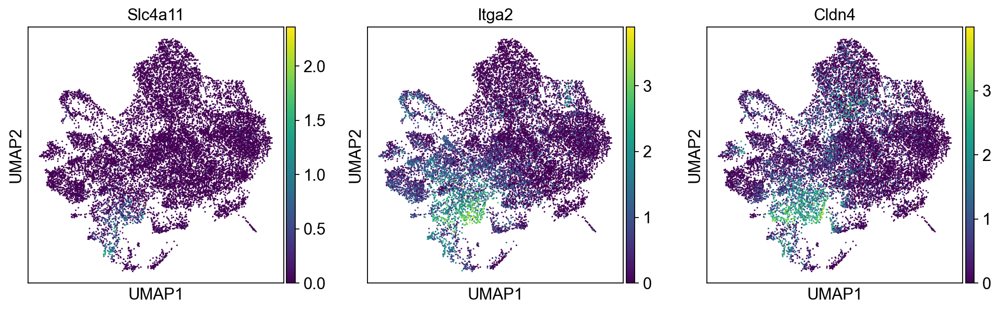

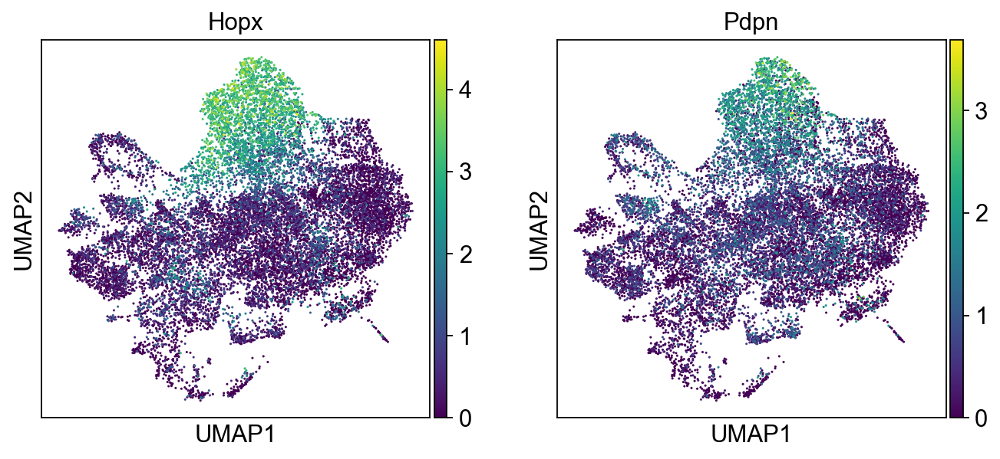

In [17]:
sc.pl.umap(adata, color=['batch','Classification',])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

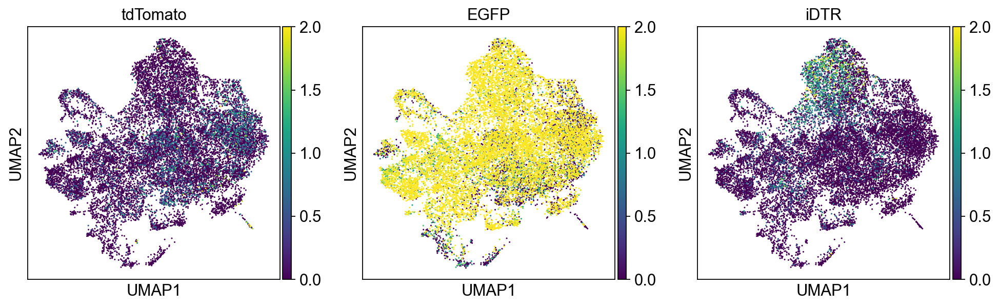

In [18]:
sc.pl.umap(adata, color=['tdTomato','EGFP','iDTR'], vmax=2) #,'mScarlet'

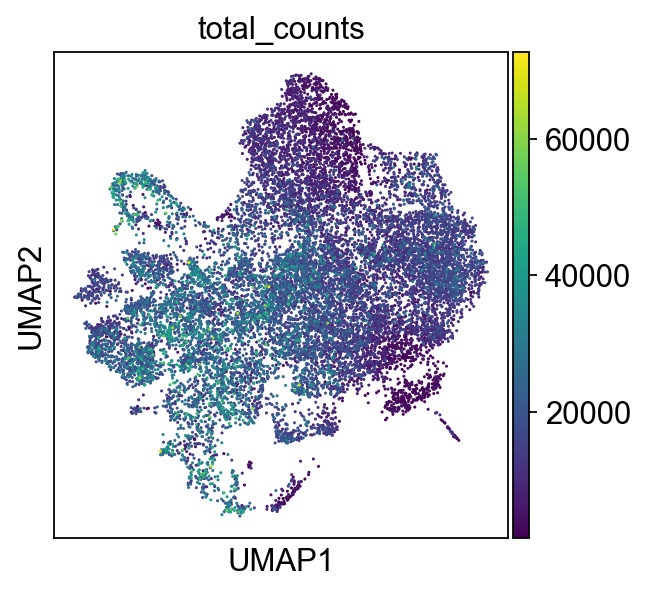

In [19]:
sc.pl.umap(adata, color=['total_counts'])

## Define scoring Functions

In [20]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [21]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [22]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1686 total control genes are used. (0:00:01)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1191 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1388 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1491 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1890 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Fam46c', 'Gm6139', 'Ldha-ps2', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1790 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Clust

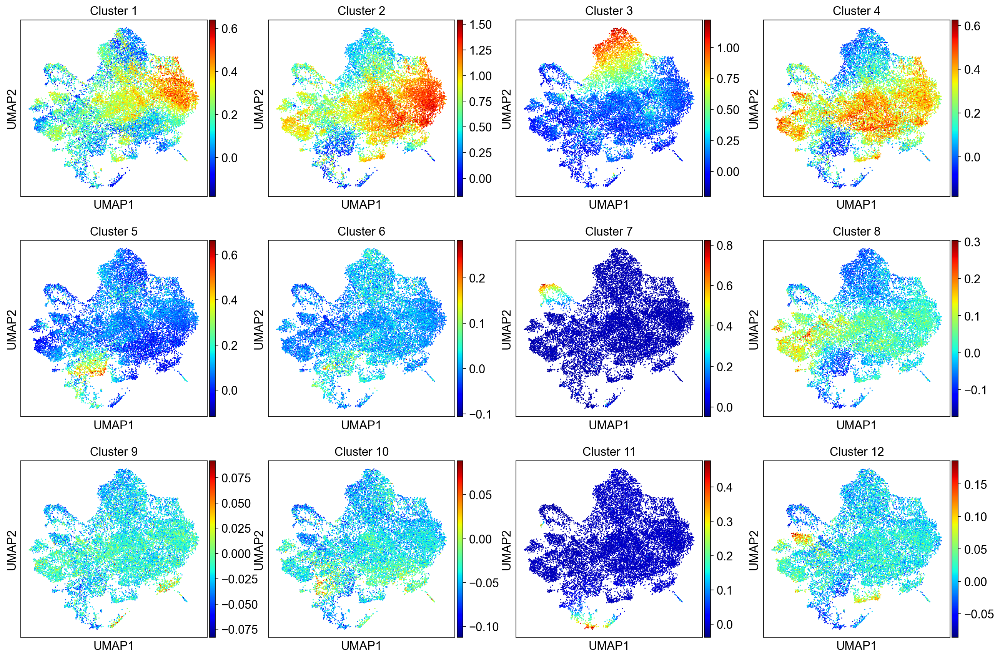

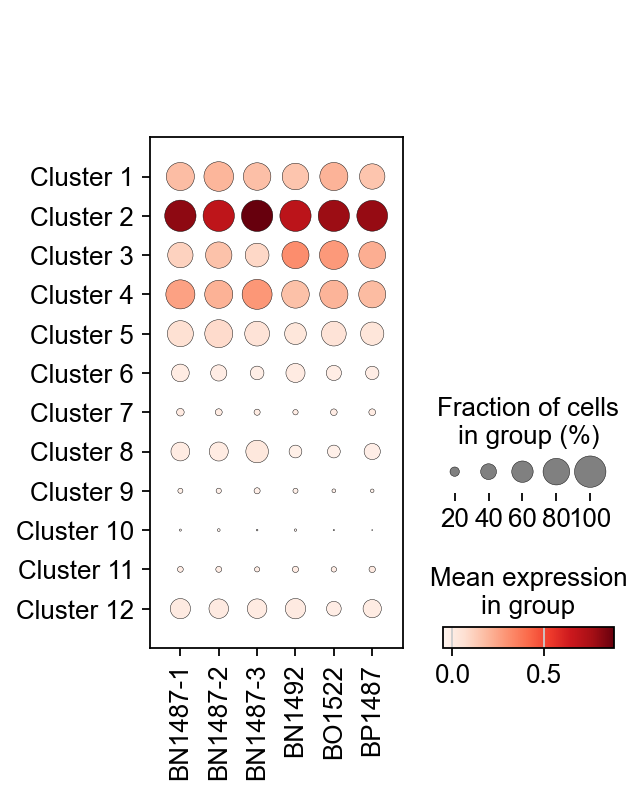

In [23]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

In [107]:
sc.tl.leiden(adata, resolution=0.35)

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


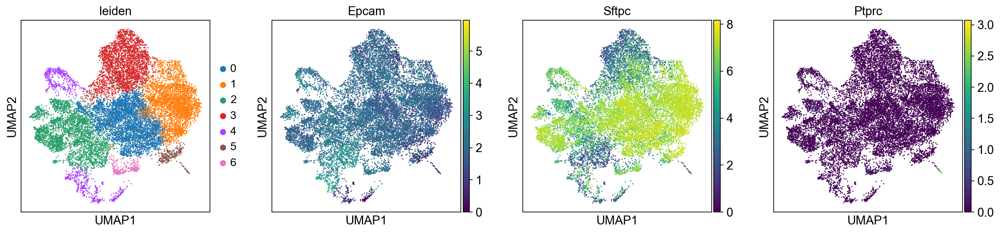

(None,)

In [108]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

In [34]:
adata.obs.Group.value_counts(sort=False)

Group
Hopx_traced_3d      5281
Hopx_traced_14d    10504
Name: count, dtype: int64

In [35]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group            Classification
Hopx_traced_3d   BN1492            2110
                 BO1522            3062
                 BP1487             109
Hopx_traced_14d  BN1487-1          2680
                 BN1487-2          2765
                 BN1487-3          5059
Name: count, dtype: int64

In [36]:
sc.tl.embedding_density(adata, basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


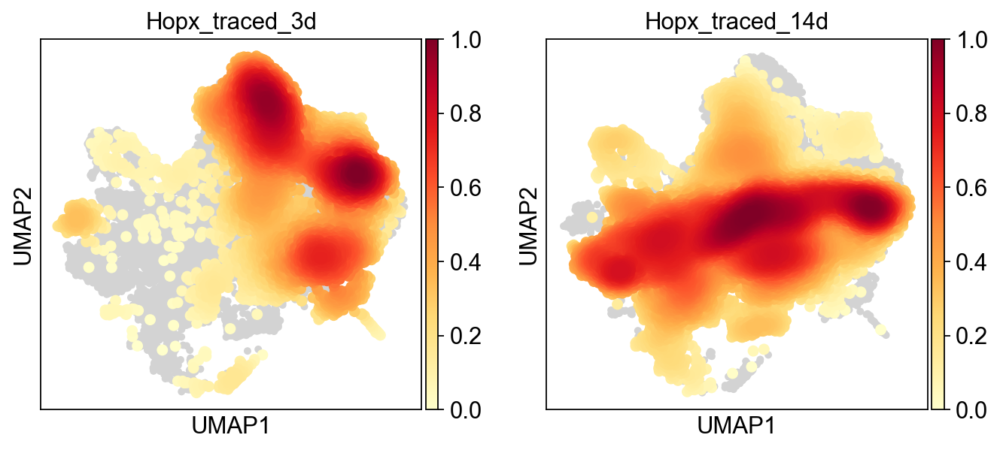

In [37]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group')

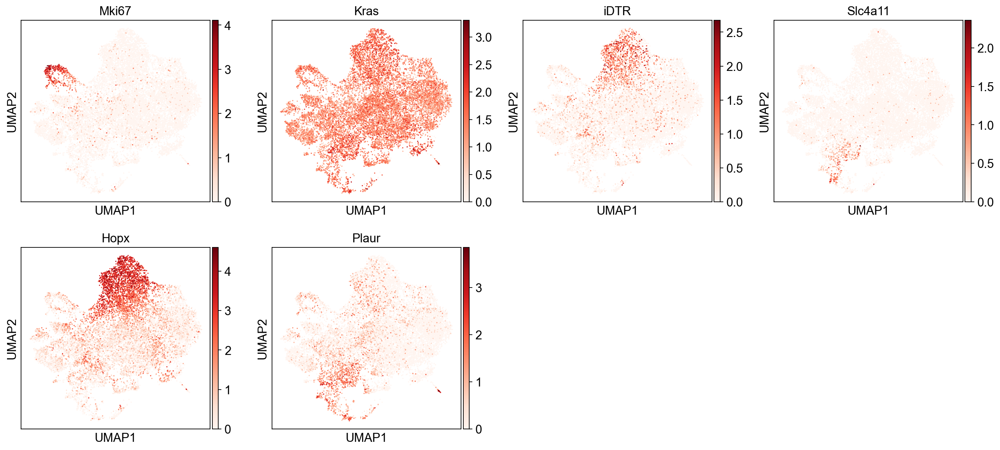

In [38]:
sc.pl.umap(adata, color=['Mki67', 'Kras','iDTR','Slc4a11','Hopx','Plaur'],cmap='Reds')

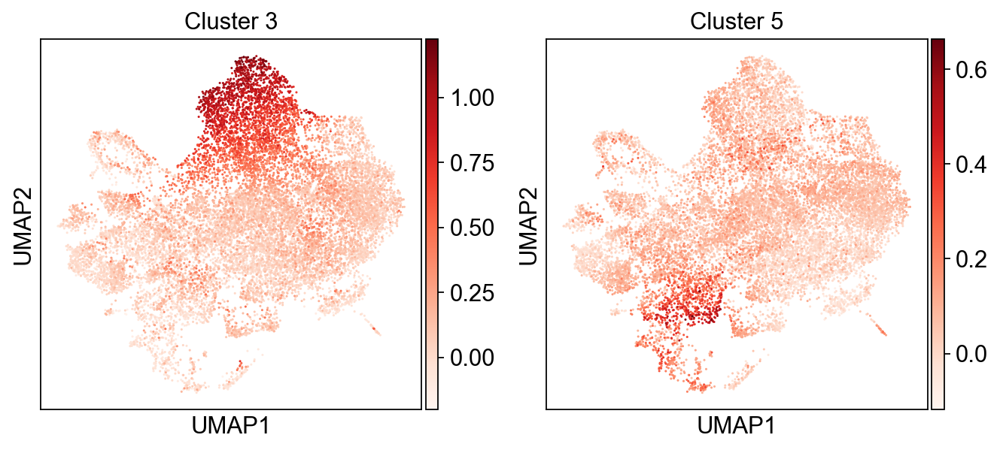

In [39]:
sc.pl.umap(adata, color=['Cluster 3','Cluster 5'], cmap='Reds')

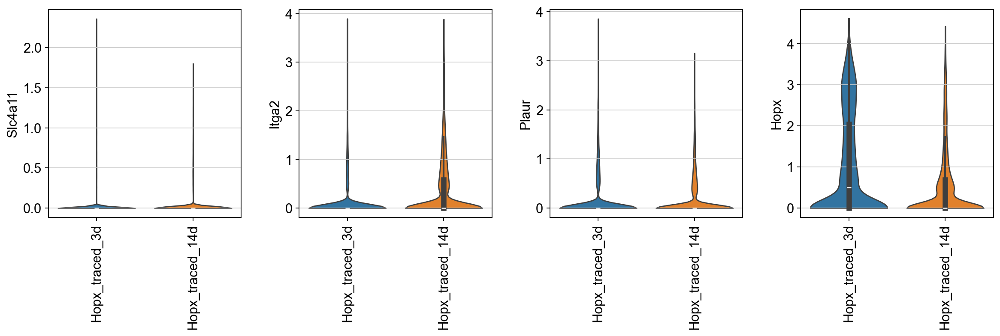

In [40]:
sc.pl.violin(adata, ['Slc4a11','Itga2','Plaur','Hopx',], 
             groupby='Group',rotation=90,inner='box',stripplot=False)

In [41]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


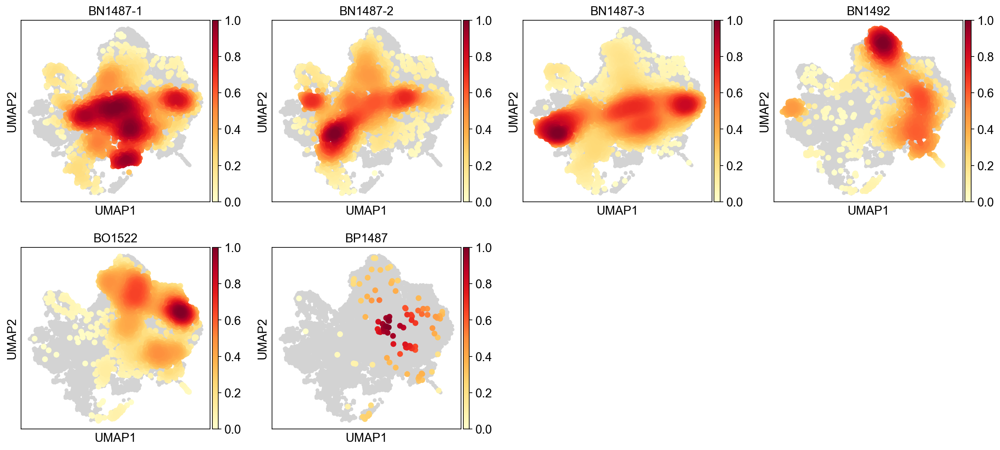

In [42]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

## Explore Phase

In [43]:
cell_cycle_genes = [x.strip() for x in open('../../common_files/regev_lab_cell_cycle_genes_mouse.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [44]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    642 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    598 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=47


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_pca/__init__.py:379: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


    finished (0:00:00)


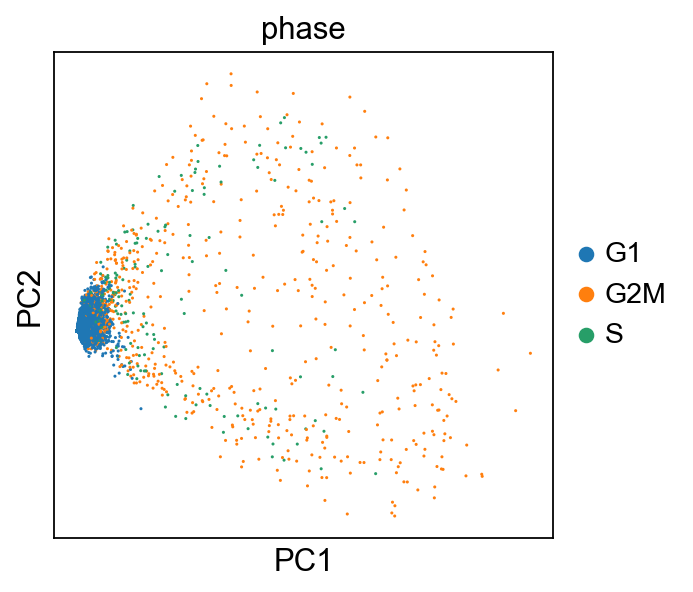

In [45]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

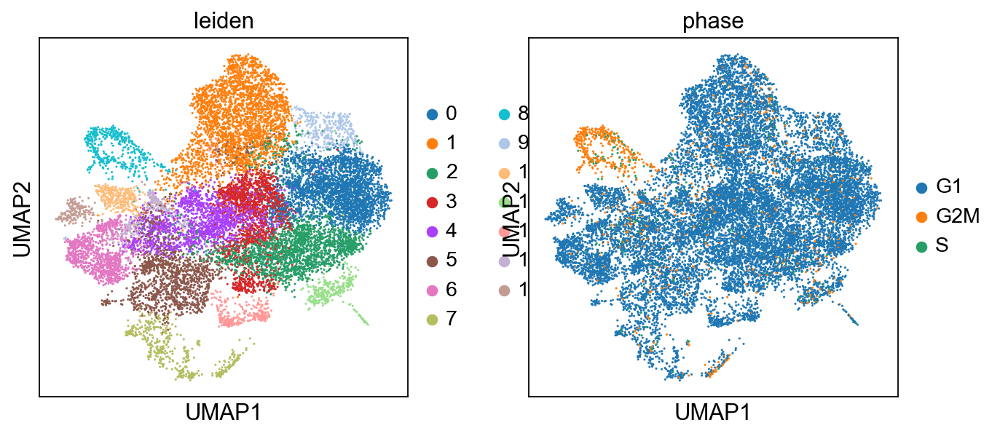

In [46]:
sc.pl.umap(adata, color=['leiden','phase'])

## Logistic Regression

In [47]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../../common_files/genes.joblib')

In [48]:
adata_log = adata[:,adata.var.index.isin(names)]

In [49]:
adata_names = [x for x in adata_log.var.index]

In [50]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [51]:
smartseq = anndata.read('../../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [52]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [53]:
names = [x for x in names_adata.var.index]

In [54]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [55]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[143,   5,   1,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  9,  68,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  40,   0,   4,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  68,   0,   0,   0,   7,   1,   0,   0,   0],
       [  0,   0,   2,   0, 183,   1,   0,   2,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   2,   0,   0,   3,   0,  55,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

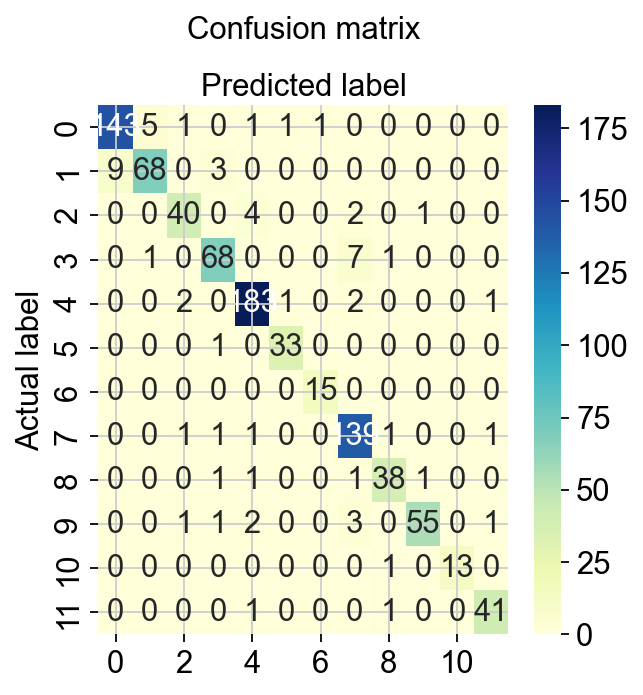

In [56]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [57]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.94      0.94      0.94       152
           2       0.92      0.85      0.88        80
           3       0.89      0.85      0.87        47
           4       0.91      0.88      0.89        77
           5       0.95      0.97      0.96       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.90      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.96      0.87      0.92        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.93       900
   macro avg       0.93      0.92      0.93       900
weighted avg       0.93      0.93      0.93       900



In [58]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [59]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

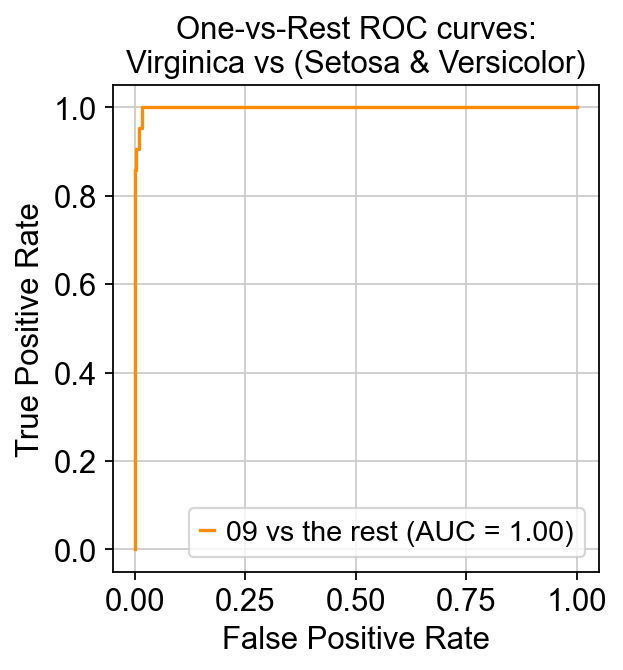

In [60]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [61]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [62]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [63]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,1.109440e-08,7.852490e-05,8.666129e-02,1.244826e-02,7.777315e-07,3.265744e-05,3.024331e-04,9.000477e-01,1.583488e-06,1.411194e-05,1.532967e-05,3.973396e-04,0.900048,0
1,01,01,9.999863e-01,2.067115e-07,1.156824e-08,1.042334e-07,1.080006e-07,1.243729e-06,1.184357e-05,3.418461e-10,2.428634e-09,6.262063e-09,1.221014e-07,6.372688e-09,0.999986,1
2,08,08,2.452887e-09,2.030469e-07,2.477845e-07,1.284868e-06,4.263575e-06,6.471507e-07,2.827910e-05,9.999122e-01,6.412290e-06,4.172750e-05,4.358624e-06,3.241767e-07,0.999912,1
3,05,10,2.312806e-08,4.601628e-06,1.888600e-05,1.811969e-07,5.156126e-01,5.689068e-04,5.091422e-05,2.768748e-05,2.057292e-04,4.827367e-01,5.444991e-05,7.193674e-04,0.515613,0
4,08,08,4.528186e-08,3.886086e-07,6.030561e-08,3.900166e-06,1.034070e-05,1.310961e-06,1.453776e-04,9.994585e-01,3.520465e-04,1.539003e-05,6.297788e-06,6.354998e-06,0.999458,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,1.630004e-04,9.542262e-08,2.523148e-06,2.382029e-05,9.912620e-01,4.311428e-03,2.608924e-04,1.811533e-03,5.830571e-04,1.437742e-03,1.339699e-04,9.888599e-06,0.991262,1
896,05,05,1.284407e-10,1.402946e-07,1.184194e-07,8.122881e-08,9.999923e-01,3.784104e-06,1.674232e-07,2.699535e-10,5.535309e-08,1.549351e-07,2.704617e-06,4.736945e-07,0.999992,1
897,08,08,2.214769e-06,6.557272e-05,8.484586e-06,1.244006e-02,3.725088e-08,4.238542e-06,1.036944e-04,9.858239e-01,1.367754e-03,1.381297e-04,2.000361e-05,2.591913e-05,0.985824,1
898,05,05,4.235912e-11,6.272706e-08,1.834596e-06,4.082524e-12,9.999974e-01,2.750321e-08,1.660621e-07,2.308499e-07,2.978853e-08,5.279881e-08,1.801998e-07,5.536873e-08,0.999997,1


In [64]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.37-0.88,0.373585,0.884427,0.697674
1,0.88-0.98,0.884427,0.981871,0.867188
2,0.98-1.0,0.981871,0.997213,0.953488
3,1.0-1.0,0.999204,0.999899,0.996109


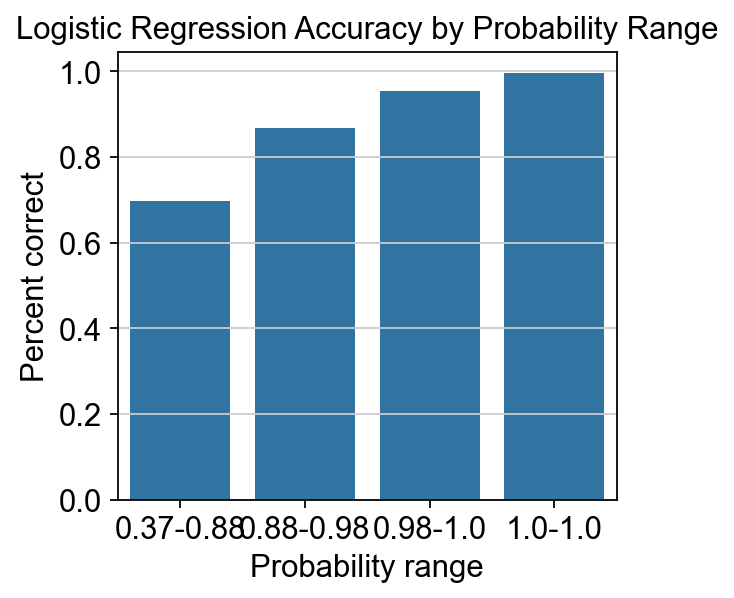

In [65]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [66]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

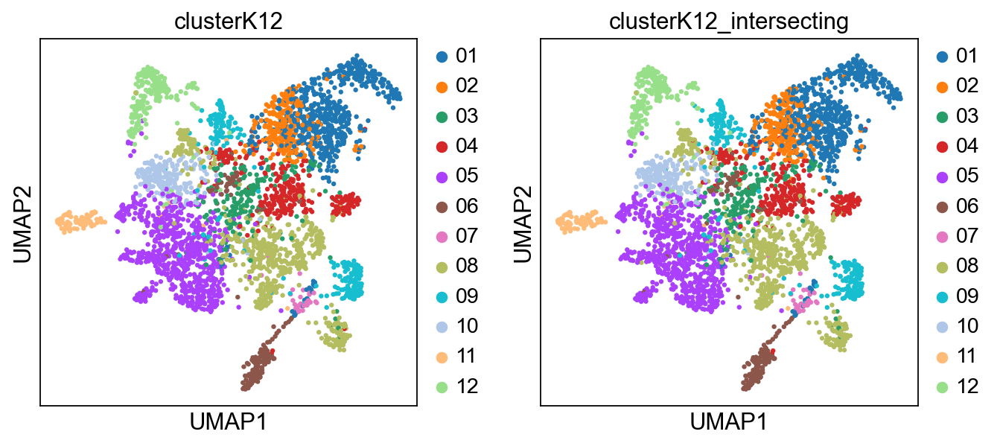

In [67]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [68]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [69]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9822222222222222

In [70]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,9.170473e-13,8.166144e-11,7.160249e-11,2.154612e-13,1.529255e-08,2.396658e-11,2.780066e-09,8.214410e-12,1.017547e-10,9.175833e-11,1.000000e+00,7.880836e-10,1.000000
1,12,1.044393e-10,1.786957e-11,7.077056e-11,1.428308e-09,1.792102e-09,5.770649e-07,1.295223e-08,2.913214e-08,5.902260e-08,3.083224e-07,6.314944e-09,9.999990e-01,0.999999
2,05,9.038737e-04,1.707286e-07,3.043258e-04,1.427508e-07,9.987745e-01,1.257622e-05,4.838826e-07,8.188630e-11,1.546208e-07,9.104974e-07,6.813176e-07,2.132210e-06,0.998775
3,10,4.825095e-07,3.611216e-07,4.028928e-07,1.328043e-03,4.691867e-07,7.392167e-06,6.024831e-06,2.253804e-03,7.151185e-06,9.963776e-01,3.464876e-06,1.484102e-05,0.996378
4,01,9.999976e-01,3.689937e-09,9.509835e-07,1.106623e-06,4.511700e-09,6.093181e-08,3.728501e-08,1.485708e-10,7.285855e-11,4.570574e-09,1.904362e-07,8.499829e-09,0.999998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,1.846633e-10,7.159087e-08,5.578761e-09,9.455063e-08,8.836326e-09,5.471451e-09,4.727627e-07,9.999963e-01,2.861862e-06,1.007769e-07,4.406382e-08,7.113433e-09,0.999996
3596,09,5.974211e-08,1.790312e-07,1.021411e-07,7.352513e-08,1.072042e-06,4.080833e-08,1.107361e-06,2.427647e-04,9.997515e-01,2.124254e-07,2.734824e-06,1.043412e-07,0.999752
3597,08,3.233014e-08,3.562163e-06,7.817766e-08,4.381536e-05,1.695580e-08,4.602161e-08,6.584483e-06,9.998505e-01,9.046385e-05,2.264049e-06,1.891472e-06,7.724048e-07,0.999850
3598,08,5.226857e-09,1.665541e-06,2.430514e-06,1.472671e-06,4.585003e-04,2.020578e-07,8.844402e-06,9.994989e-01,9.778914e-06,1.296393e-05,3.521091e-06,1.669925e-06,0.999499


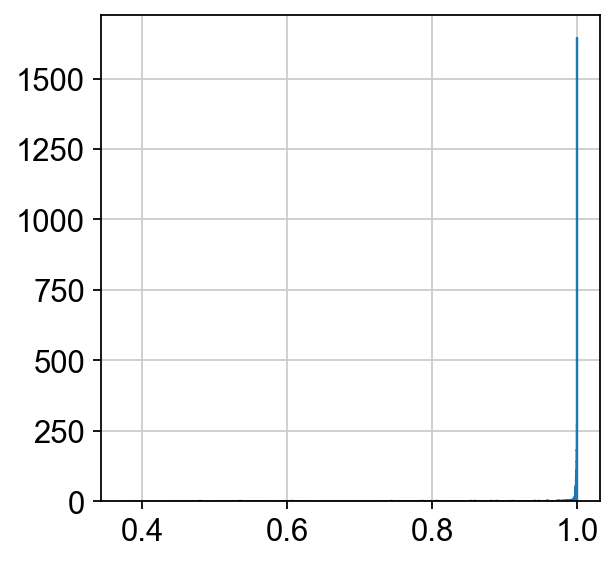

In [71]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [72]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [73]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [74]:
y_pred = logreg.predict(adata_log_ordered.X)

In [75]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [76]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

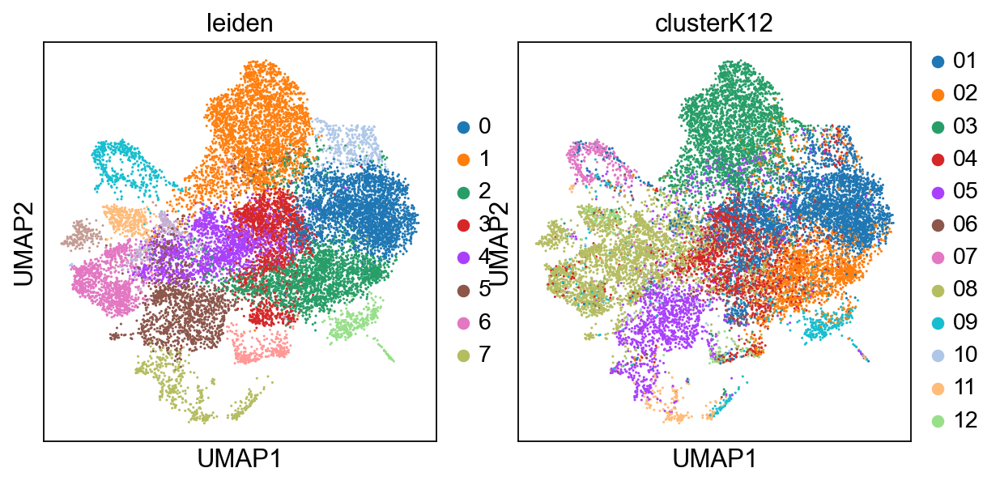

In [77]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

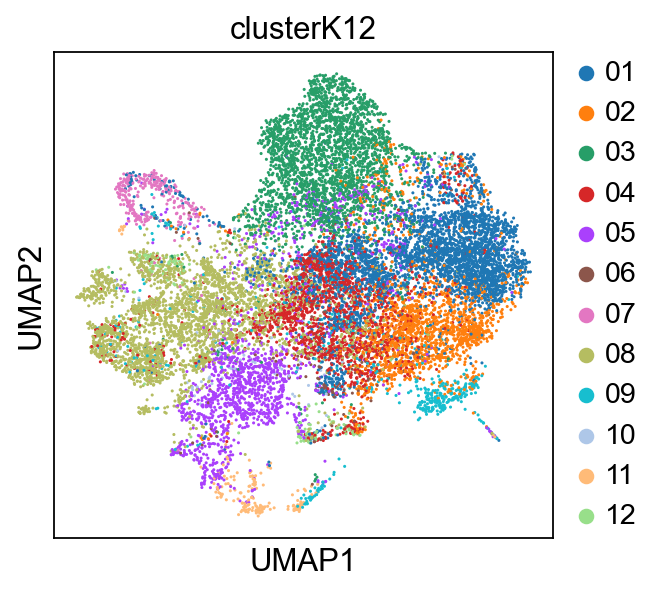

In [78]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

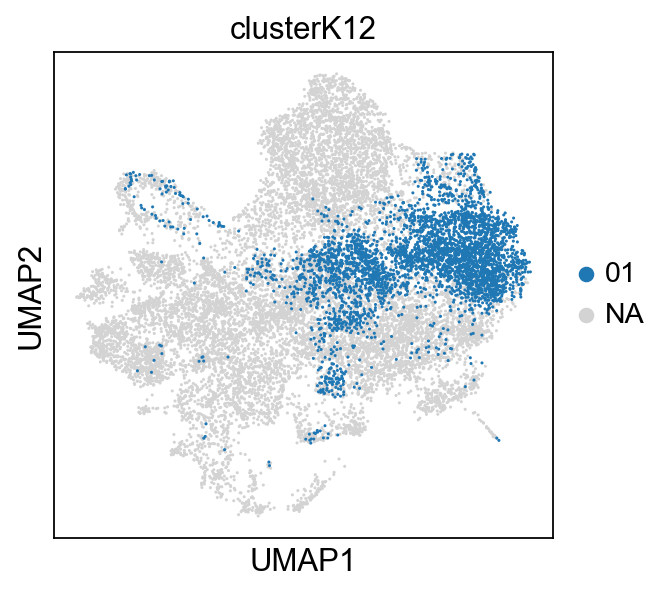

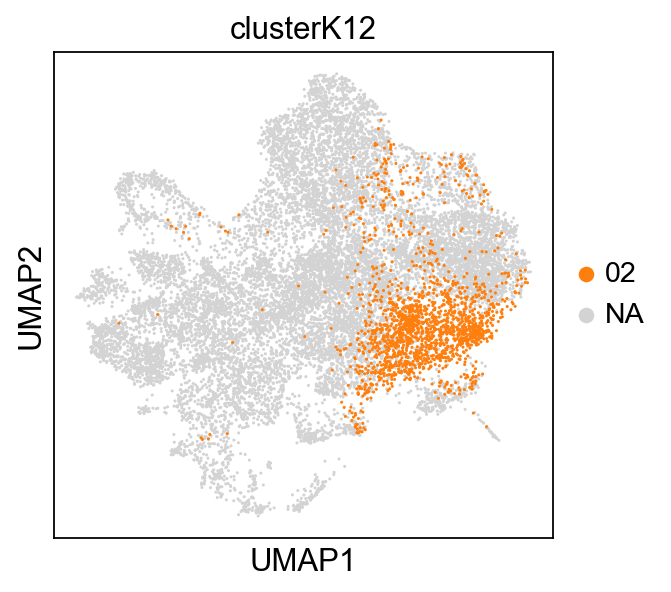

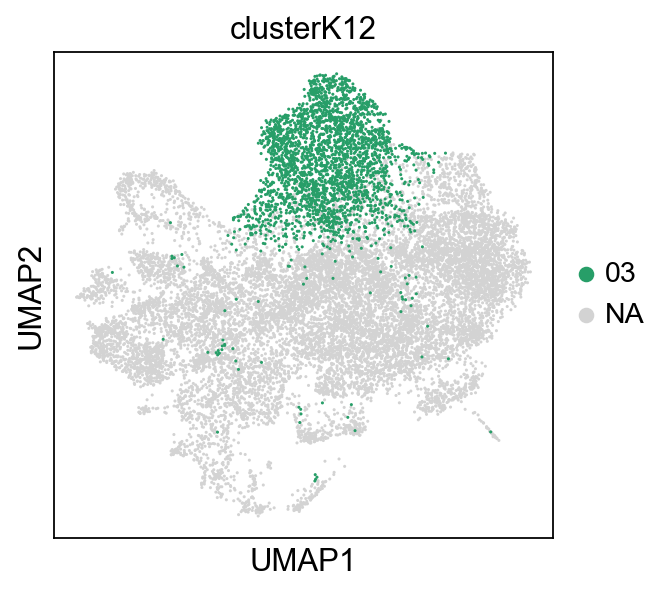

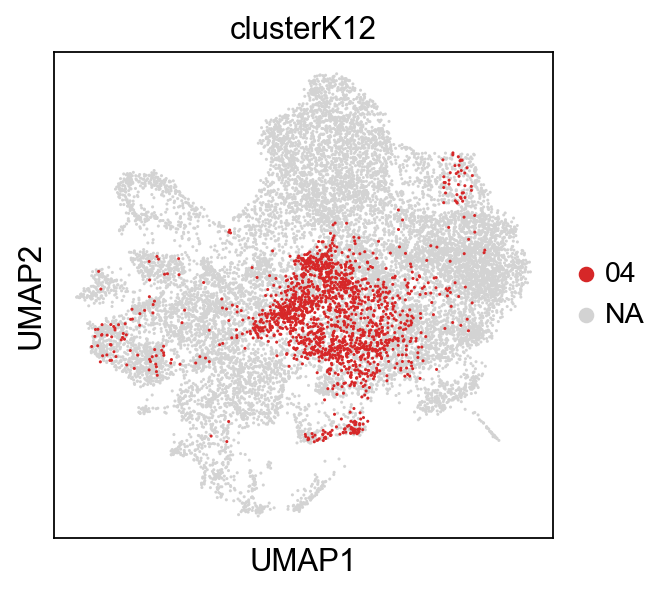

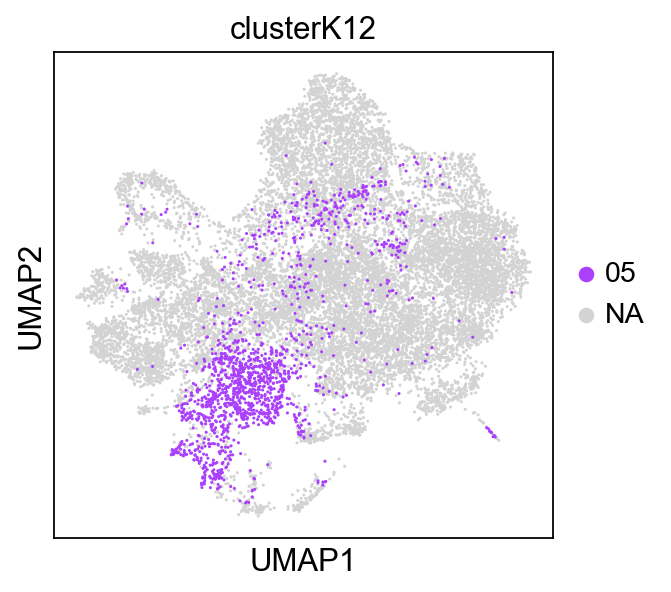

...

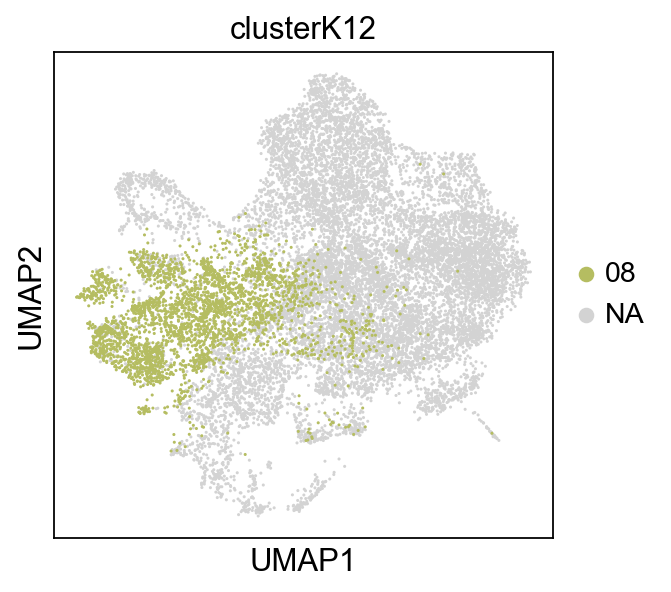

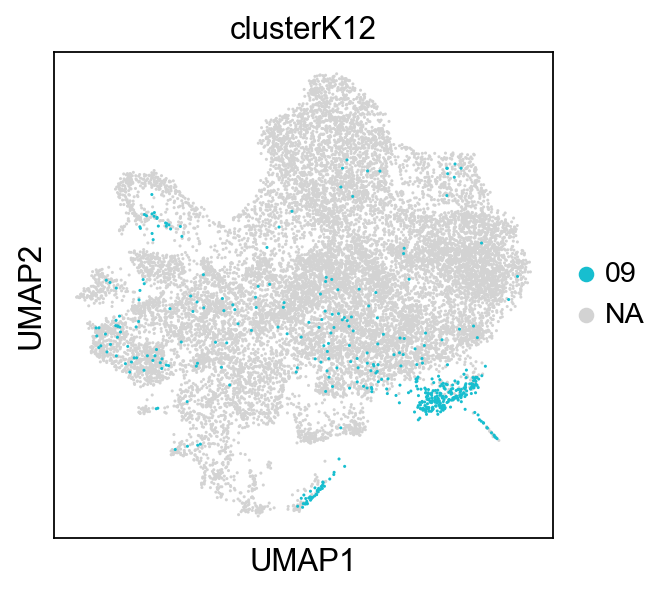

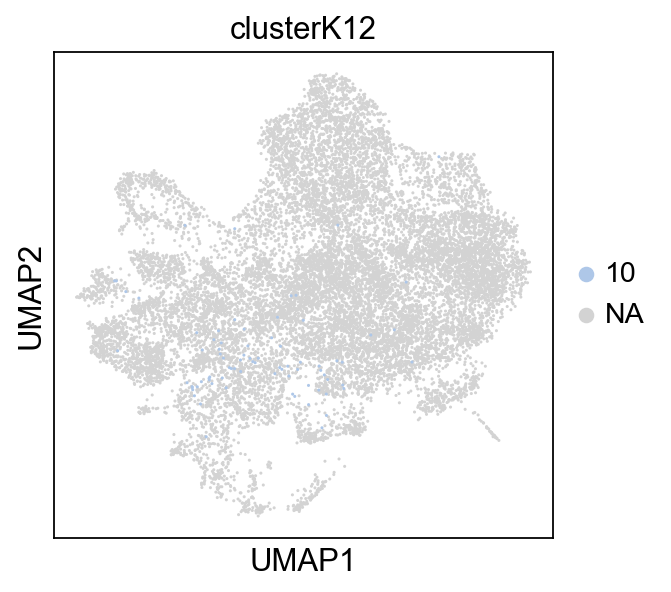

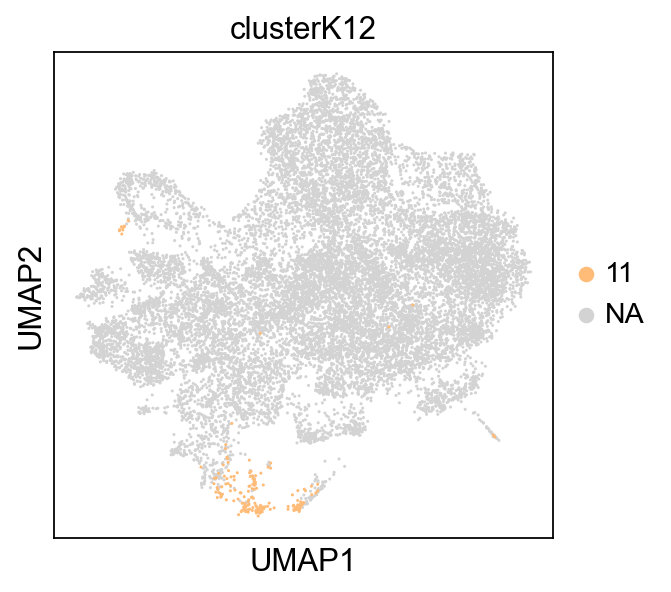

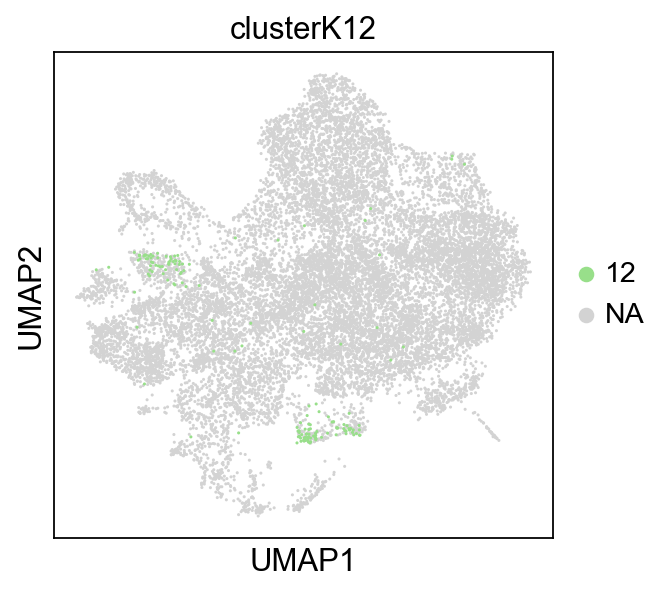

In [79]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [80]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

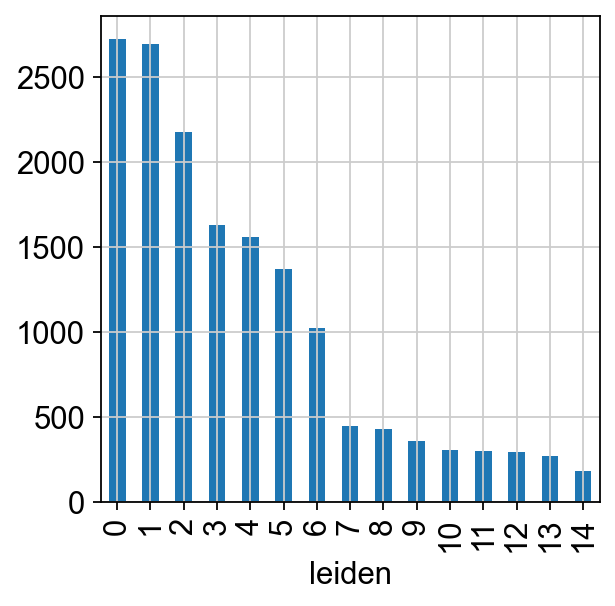

In [81]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

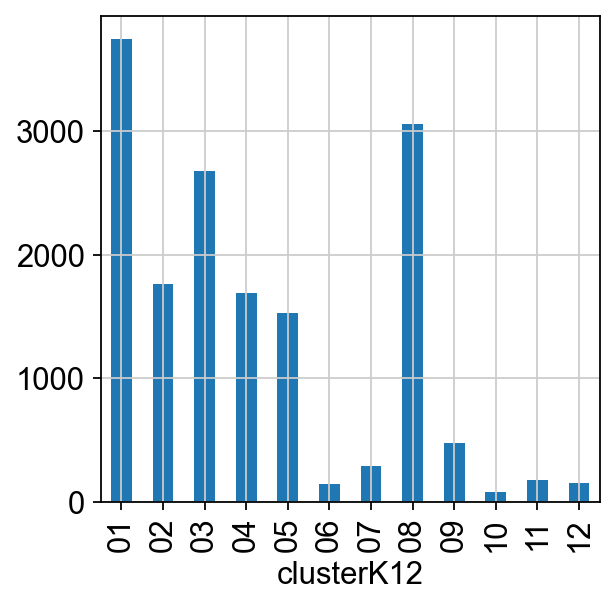

In [82]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

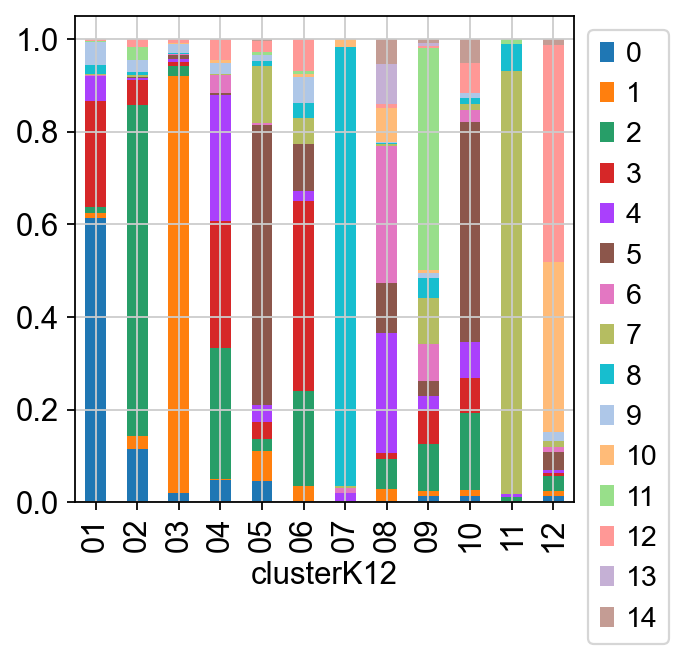

In [109]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [84]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,01,9.434575e-01,0.001241,0.051095,2.778734e-04,0.000068,0.002777,1.022603e-04,1.389028e-05,2.601803e-05,0.000171,2.593955e-04,5.108630e-04,0.943458
1,03,6.940141e-11,0.000022,0.999971,5.801840e-08,0.000001,0.000002,1.800836e-07,1.604319e-09,4.080148e-08,0.000002,2.718169e-07,3.408278e-07,0.999971
2,01,5.470506e-01,0.269204,0.015045,6.981967e-03,0.002755,0.023522,6.997137e-03,1.113353e-01,1.885657e-03,0.009075,4.105621e-03,2.042895e-03,0.547051
3,03,2.581370e-07,0.000146,0.999309,1.199510e-07,0.000532,0.000002,5.991620e-07,3.223915e-08,1.238607e-06,0.000001,3.072226e-06,5.453626e-06,0.999309
4,01,9.582413e-01,0.000020,0.000095,1.840545e-03,0.019391,0.010004,1.692653e-04,1.361009e-06,2.963898e-04,0.003247,4.956440e-04,6.198141e-03,0.958241
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15780,01,9.984903e-01,0.000004,0.000200,1.691220e-05,0.000002,0.000123,9.880112e-05,5.564271e-06,7.647641e-05,0.000009,6.382914e-05,9.101953e-04,0.998490
15781,01,9.593054e-01,0.000438,0.000092,3.013760e-02,0.000478,0.001453,1.682417e-03,5.239812e-04,2.729124e-03,0.000818,1.716369e-03,6.256862e-04,0.959305
15782,04,6.624018e-02,0.000808,0.000279,8.845773e-01,0.000202,0.006263,4.338233e-03,8.482259e-03,2.151657e-02,0.002106,2.585104e-03,2.602486e-03,0.884577
15783,03,1.269660e-02,0.001012,0.815214,5.103811e-03,0.010446,0.001108,8.294783e-03,9.295757e-02,7.454917e-05,0.011873,4.943342e-03,3.627556e-02,0.815214


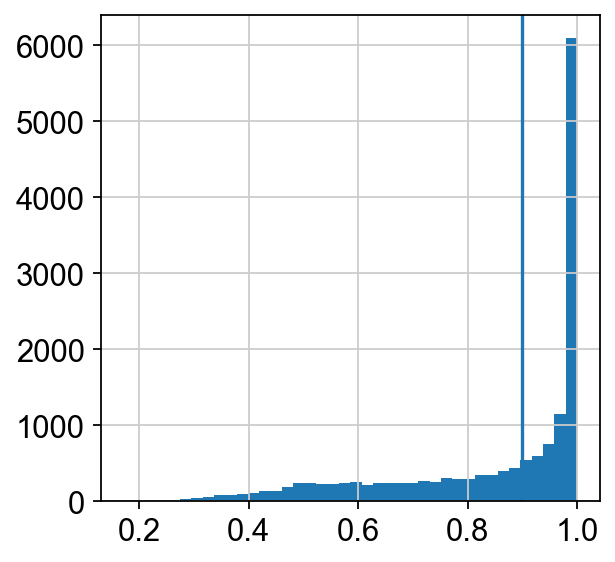

In [85]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [86]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.17-0.59,0.170,0.587
1,0.59-0.77,0.587,0.772
2,0.77-0.9,0.772,0.901
3,0.9-0.97,0.901,0.969
4,0.97-0.99,0.969,0.993
5,0.99-1.0,0.993,0.999
6,1.0-1.0,0.999,1.000


In [87]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [88]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCAAAGCCATCAA-1-First        01
AAACCAAAGCTAACTG-1-First        03
AAACCAAAGGGCTGAA-1-First     other
AAACCAAAGGTTCGAC-1-First        03
AAACCATTCCTCTCAG-1-First        01
                             ...  
TGTGTTAGTATTAGCC-1-Second       01
TGTGTTAGTTATAGCC-1-Second       01
TGTGTTAGTTGCATGT-1-Second       04
TGTGTTAGTTTGGGCC-1-Second       03
TGTGTTGAGTGCTCGG-1-Second    other
Name: clusterK12_stringent, Length: 15785, dtype: object

In [89]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

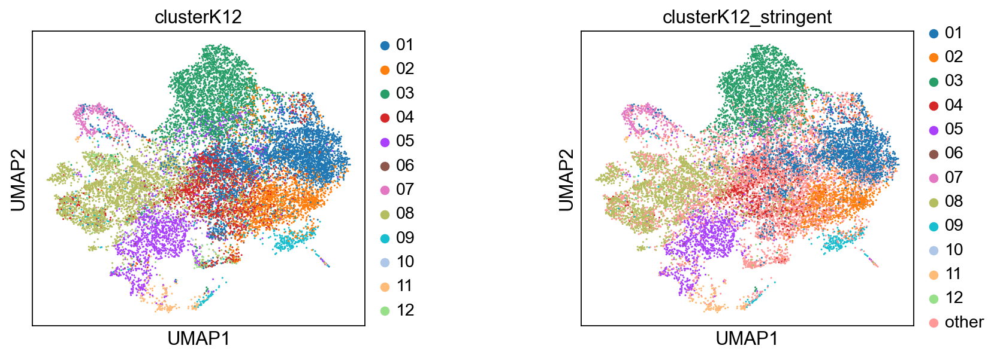

In [110]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

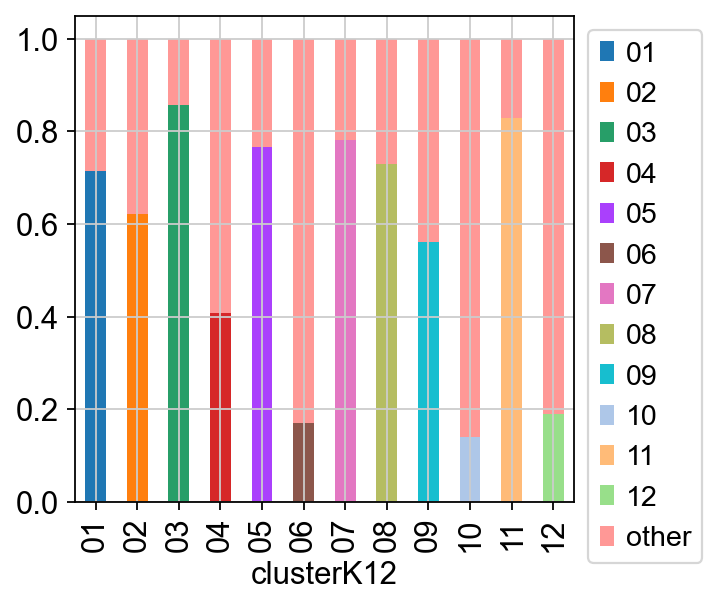

In [91]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

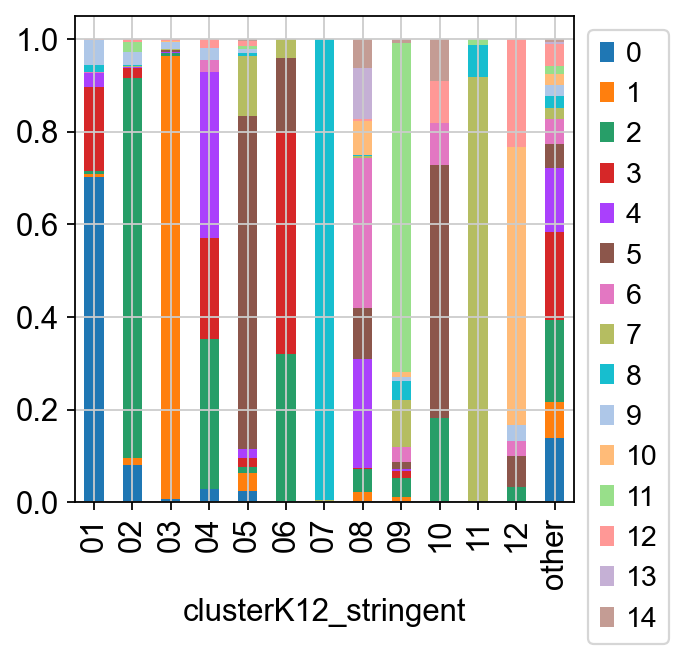

In [92]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

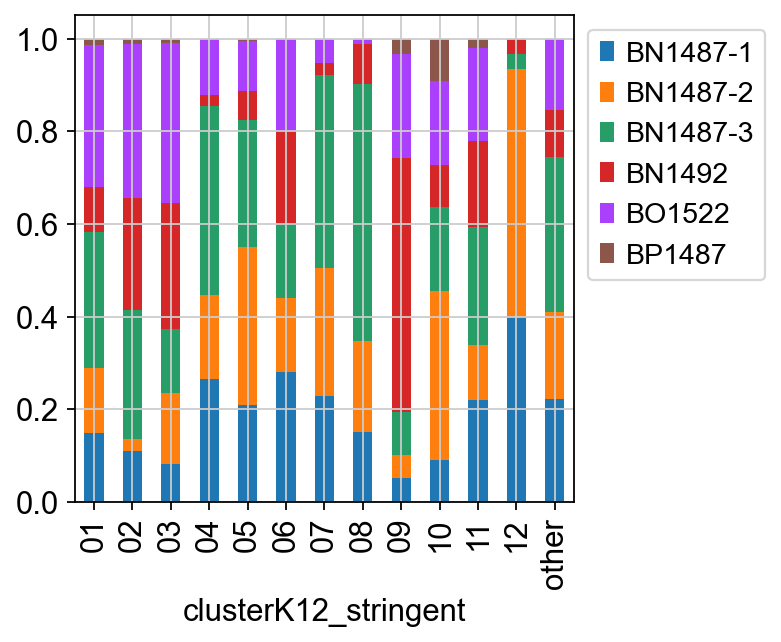

In [93]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

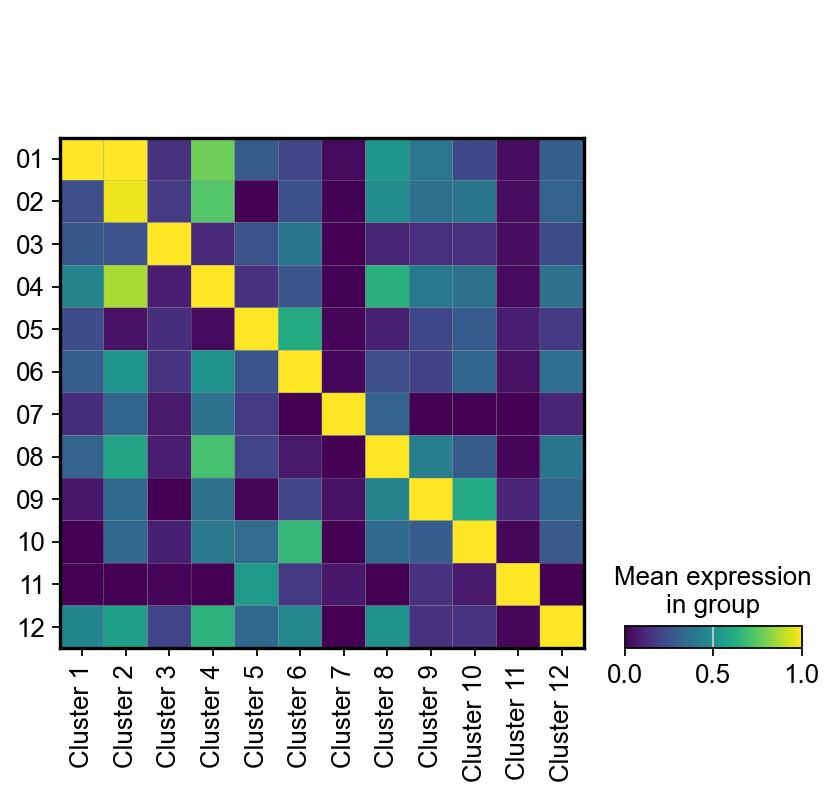

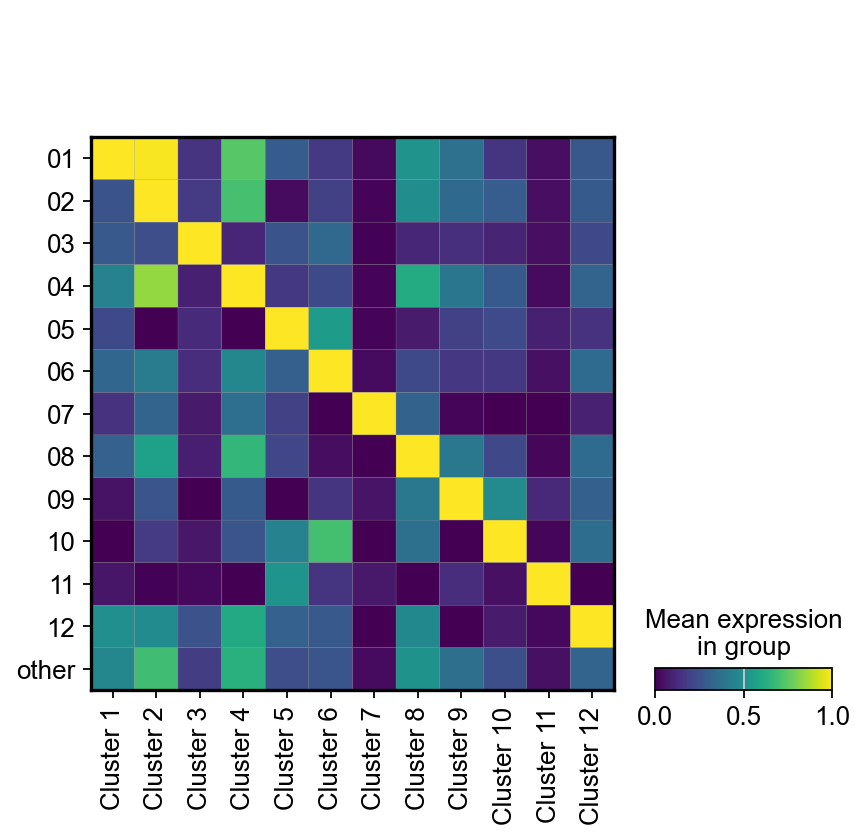

In [94]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

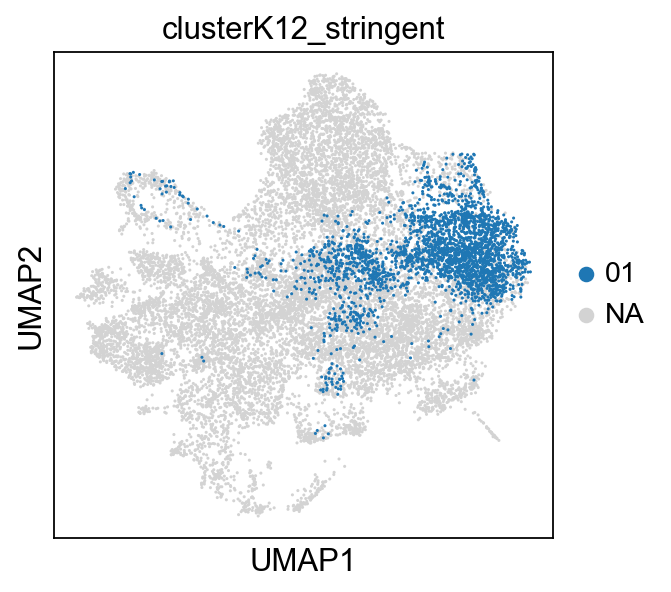

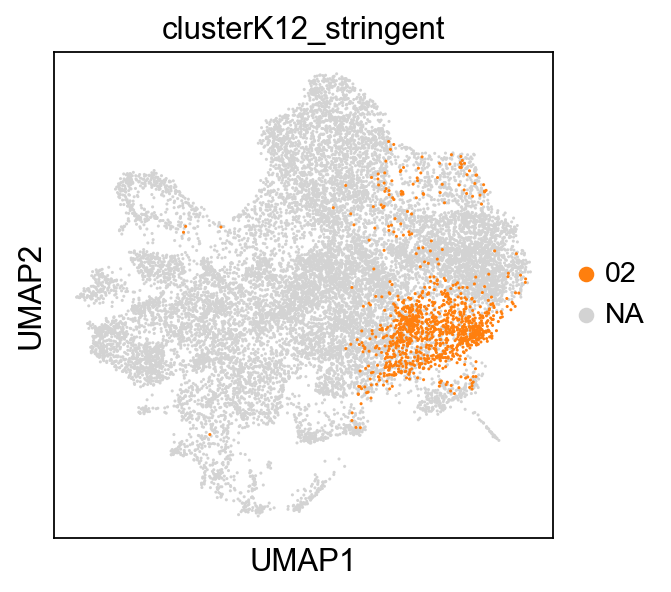

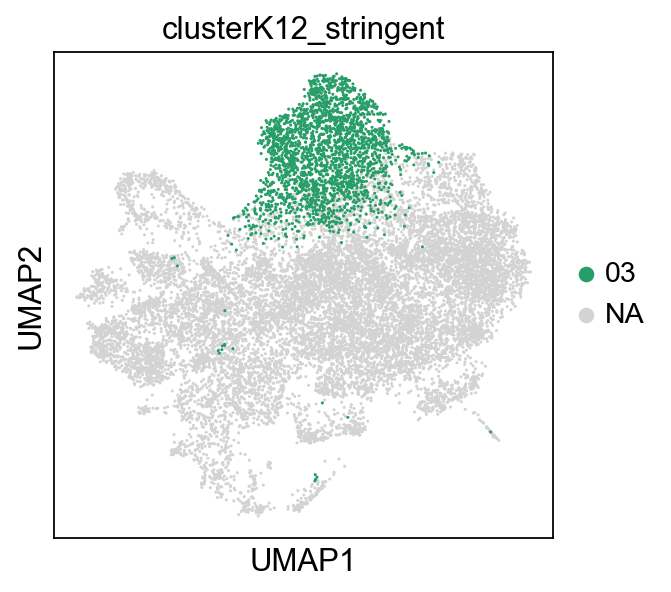

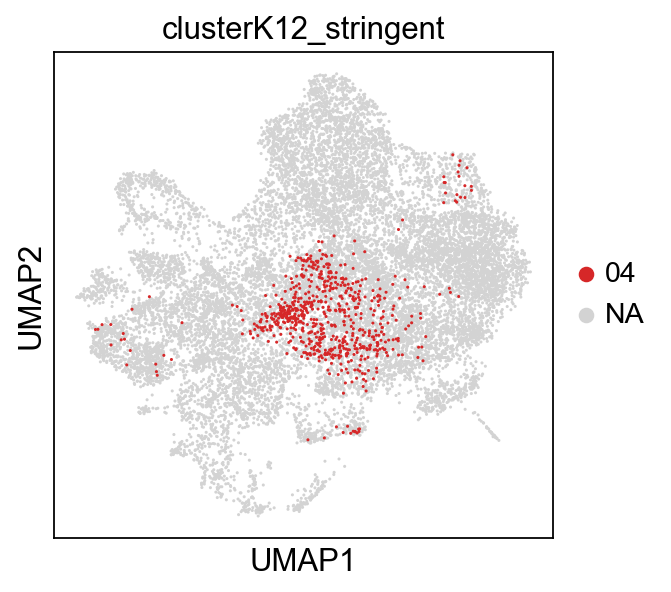

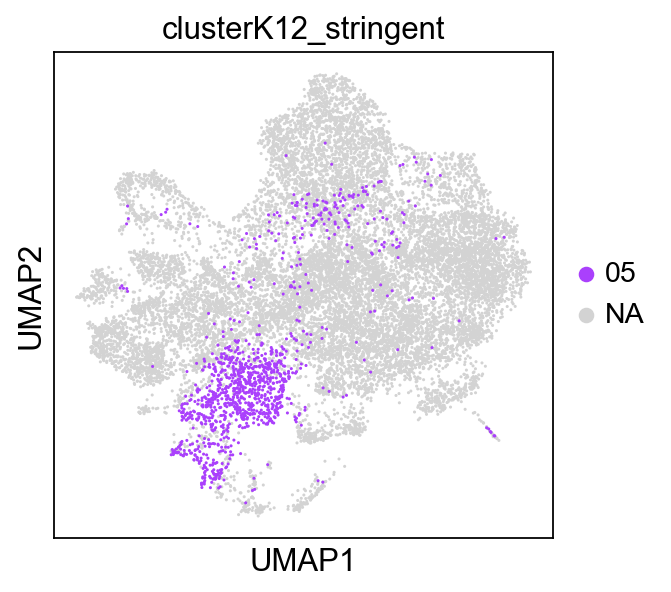

...

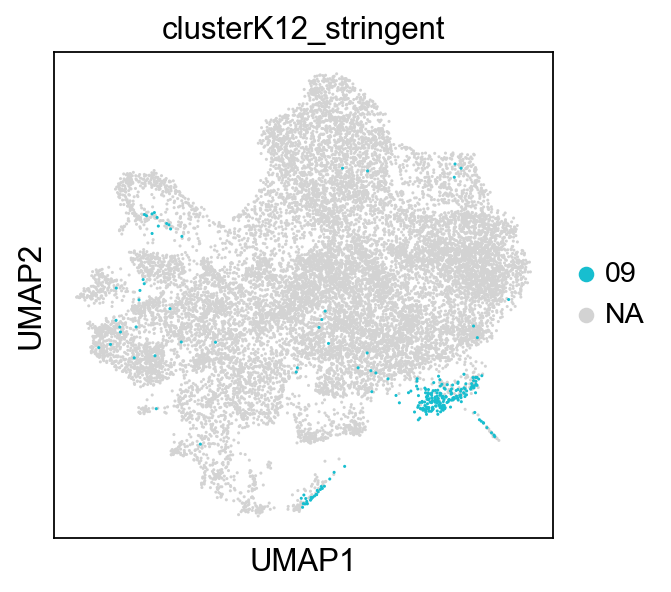

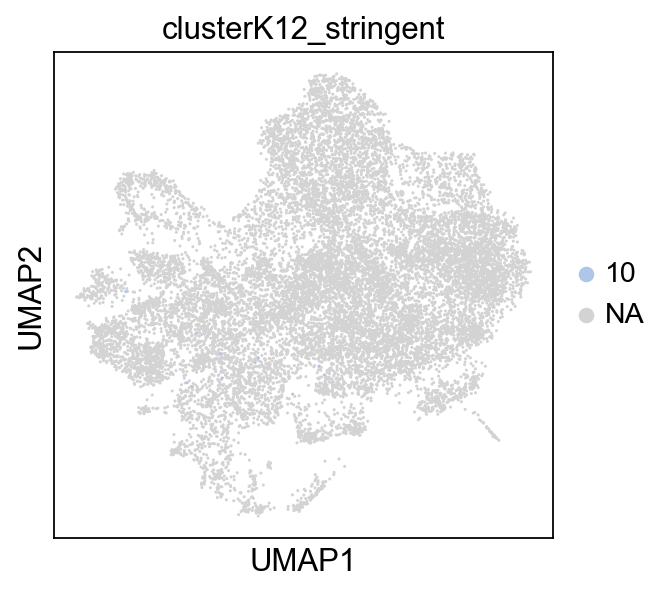

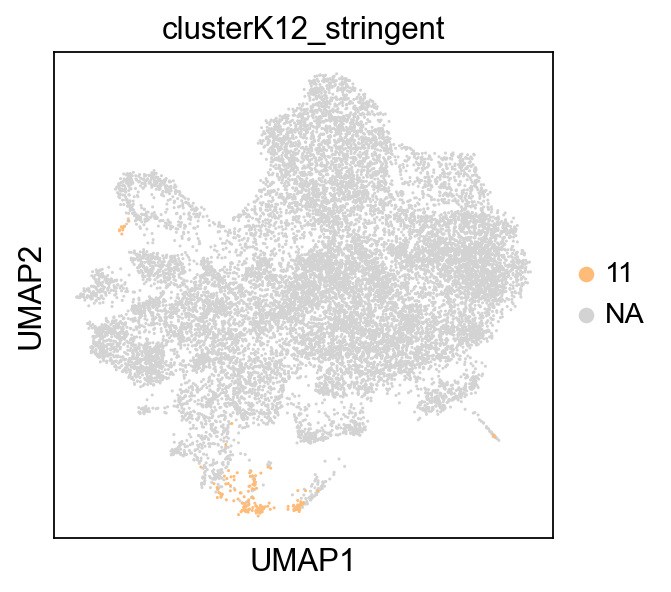

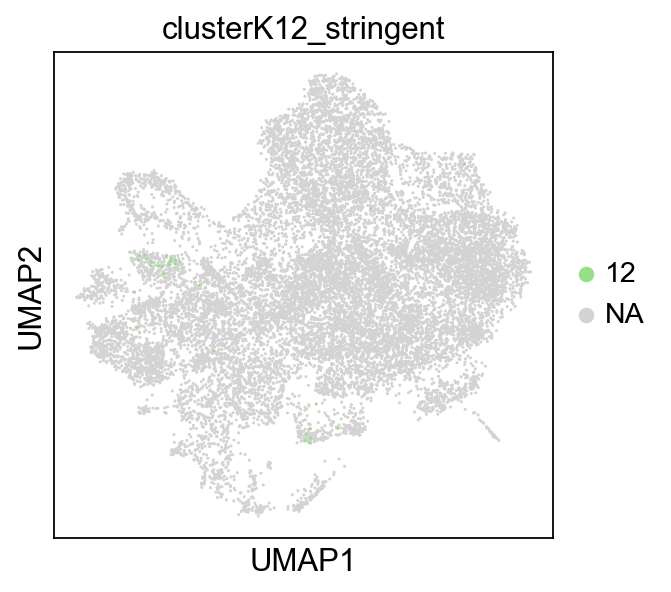

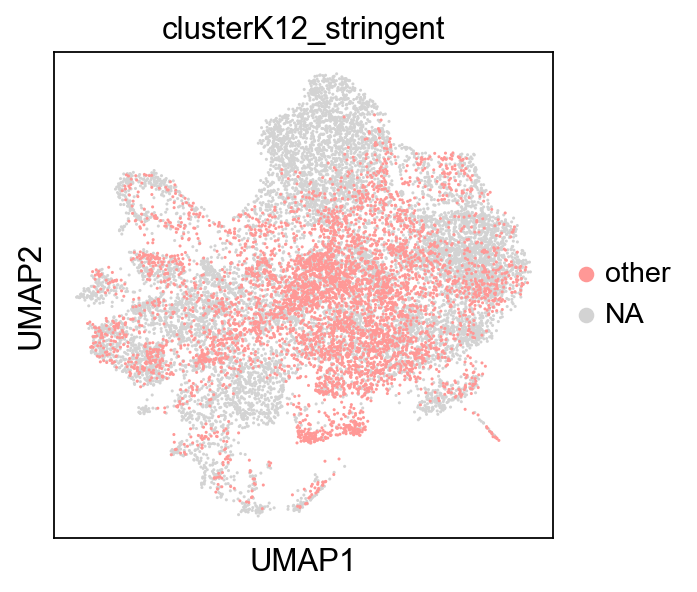

In [95]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [96]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
01    3746
08    3054
03    2676
02    1760
04    1694
05    1531
09     475
07     292
11     175
12     158
06     146
10      78
Name: count, dtype: int64

In [97]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

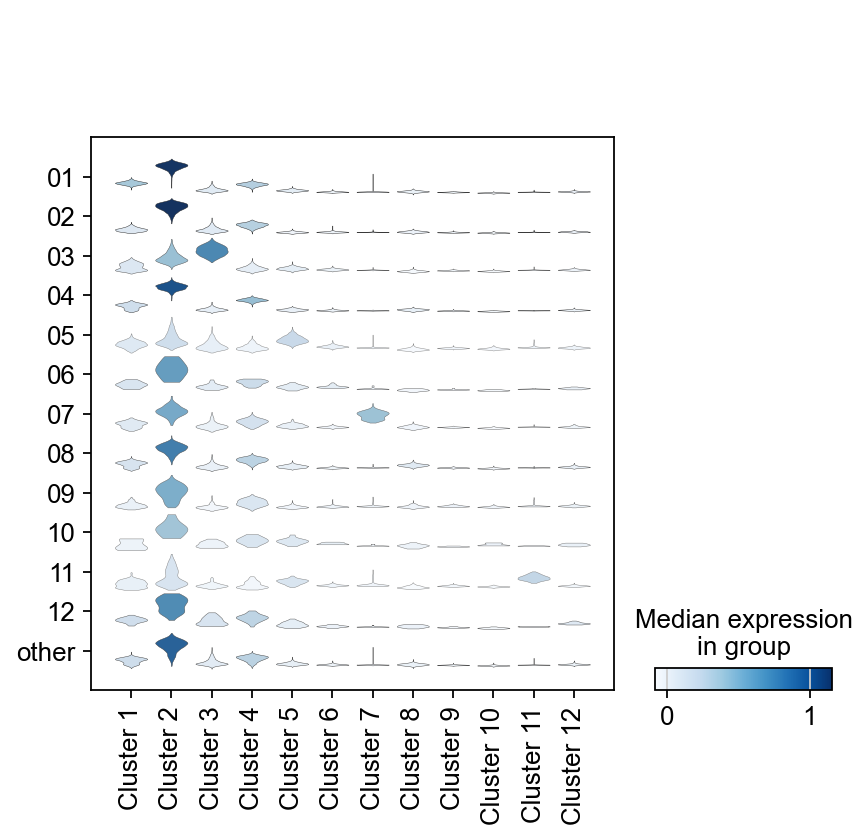

In [98]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

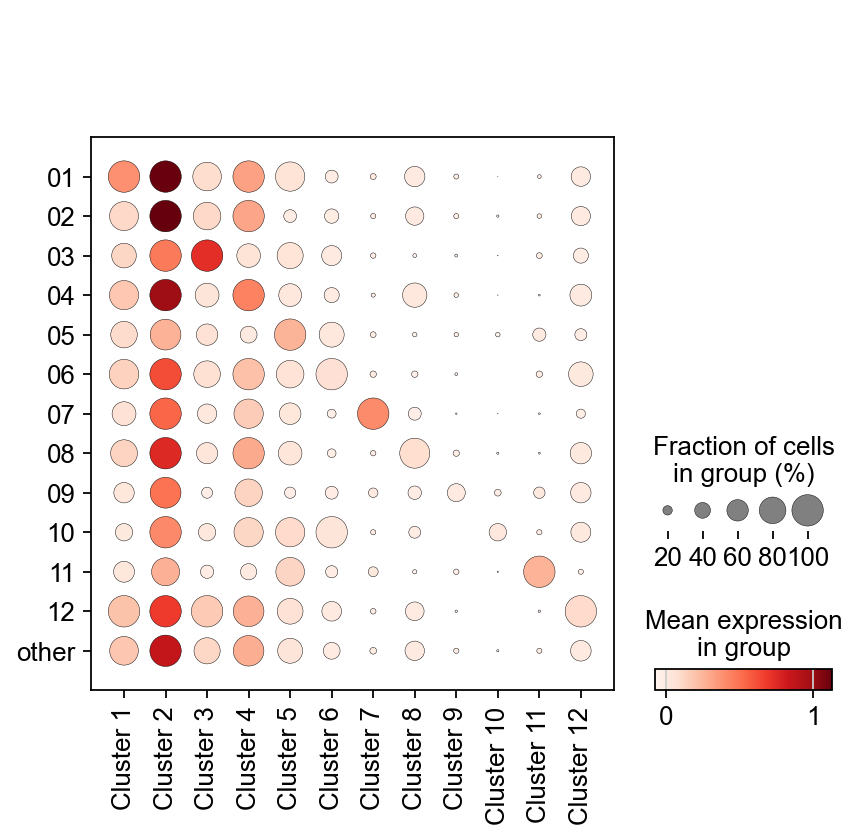

In [99]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

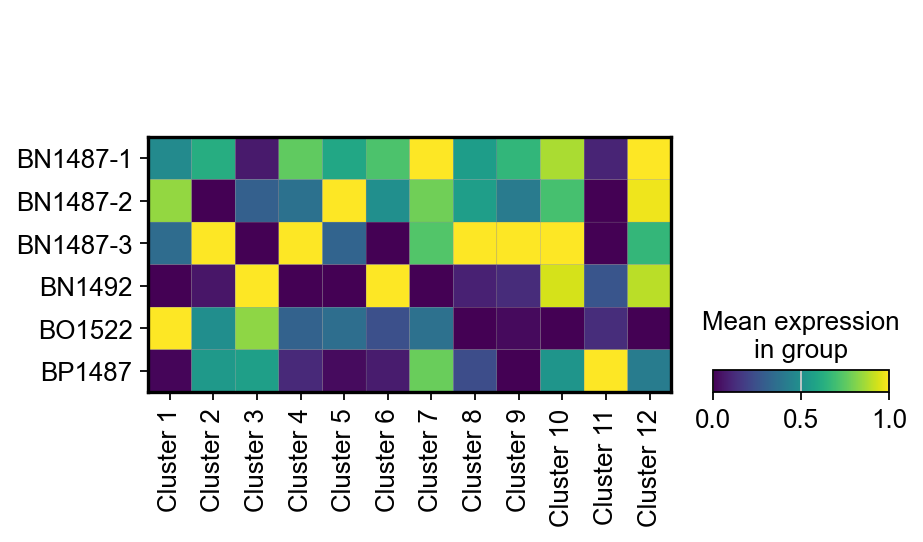

In [100]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [101]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

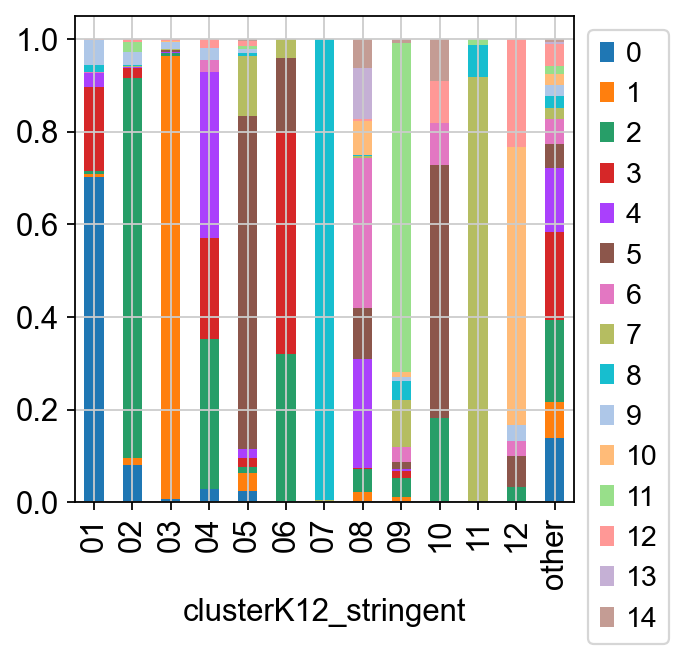

In [102]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

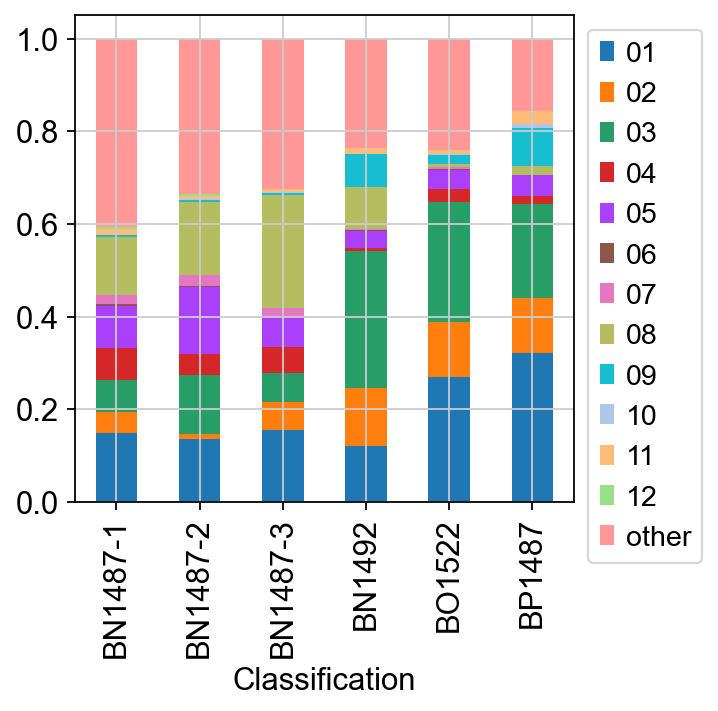

In [103]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

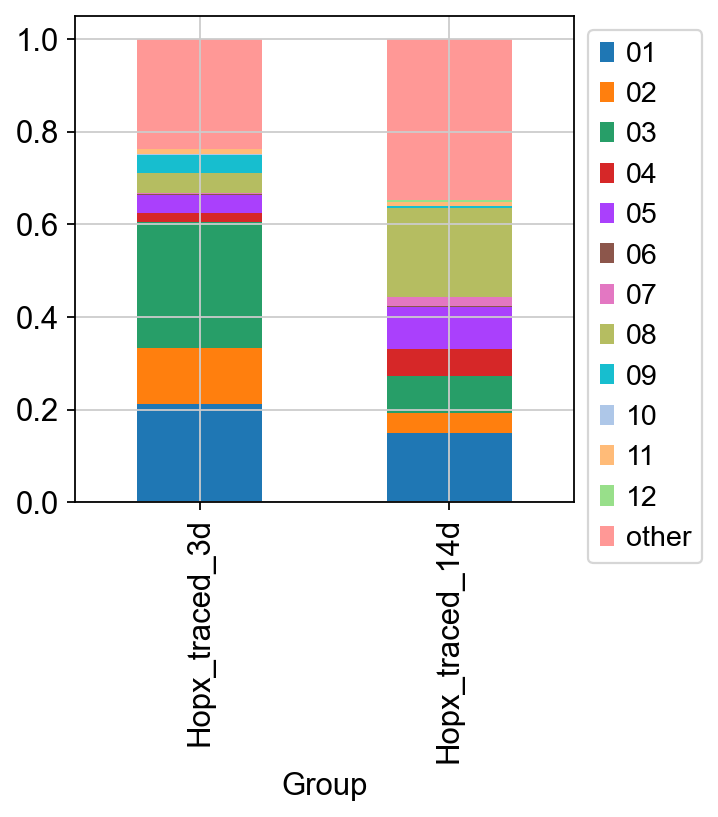

In [104]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

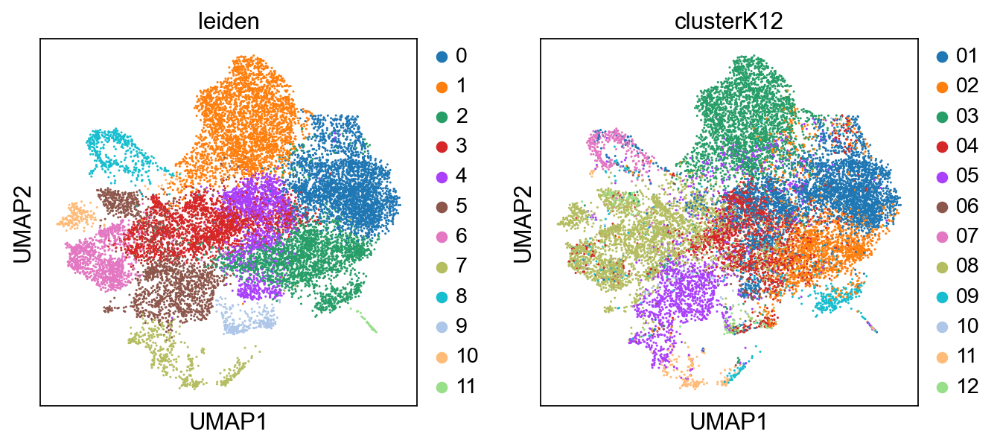

In [122]:
sc.pl.umap(adata, color=['leiden','clusterK12'])

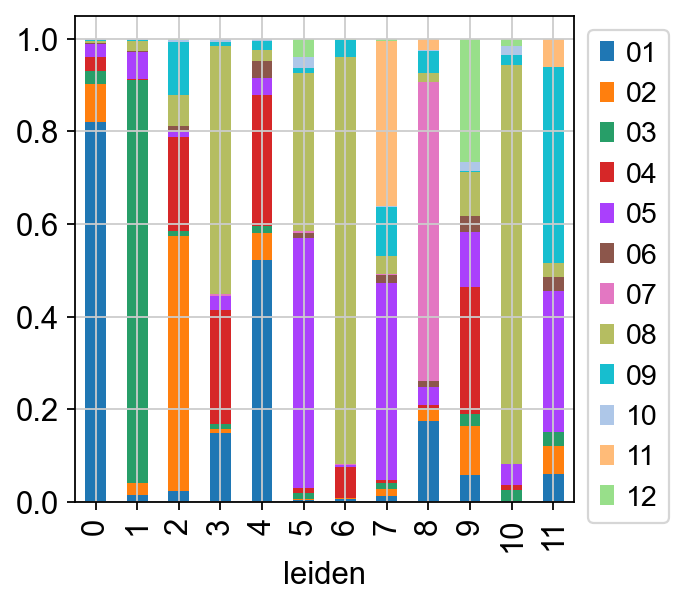

In [131]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

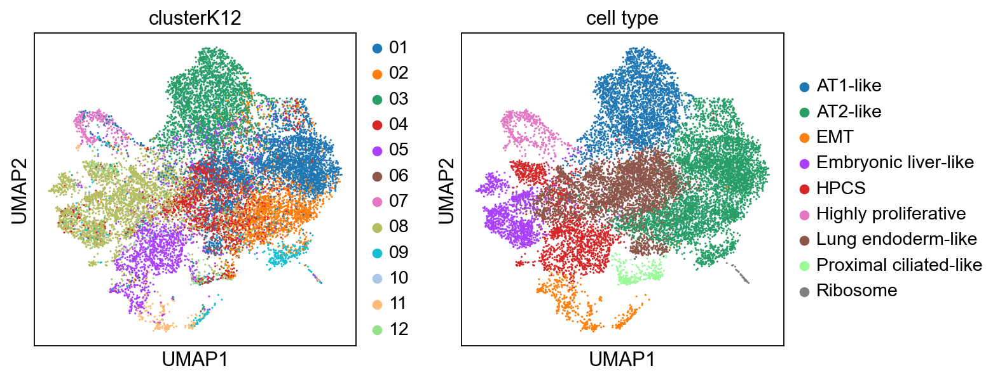

In [145]:
cluster2annotation = {
    "0": "AT2-like",
    "1": "AT1-like",
    "2": "AT2-like",
    "3": "Lung endoderm-like",
    "4": "Lung endoderm-like",
    "5": "HPCS",
    "6": "Embryonic liver-like",
    "7": "EMT",
    "8": "Highly proliferative",
    "9": "Proximal ciliated-like",
    "10": "Embryonic liver-like",
    "11": "Ribosome", 
}
adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")

#"AT1-like","AT2-like",'EMT', 'HPCS',"Lung Endoderm-like",'Highly Proliferative','Embryonic liver-like'
#adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#ff7f0e', '#d62728', '#8c564b','#e377c2', '#aa40fc']

adata.uns['cell type_colors'] = ['#1f77b4','#279e68','#ff7f0e', '#aa40fc','#d62728','#e377c2','#8c564b','palegreen','gray']
#sc.pl.umap(adata, color=['clusterK12','cell type'])

#adata.uns['cell type_colors'] = ['#1f77b4','#279e68','#ff7f0e', '#8c564b', '#d62728', '#e377c2', '#aa40fc']
sc.pl.umap(adata, color=['clusterK12','cell type'])

## Evaluate stringency

In [146]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_27460/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [147]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCAAAGCCATCAA-1-First        01
AAACCAAAGCTAACTG-1-First        03
AAACCAAAGGGCTGAA-1-First     other
AAACCAAAGGTTCGAC-1-First        03
AAACCATTCCTCTCAG-1-First        01
                             ...  
TGTGTTAGTATTAGCC-1-Second       01
TGTGTTAGTTATAGCC-1-Second       01
TGTGTTAGTTGCATGT-1-Second       04
TGTGTTAGTTTGGGCC-1-Second       03
TGTGTTGAGTGCTCGG-1-Second    other
Name: clusterK12_stringent, Length: 15785, dtype: object

In [148]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

In [149]:
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

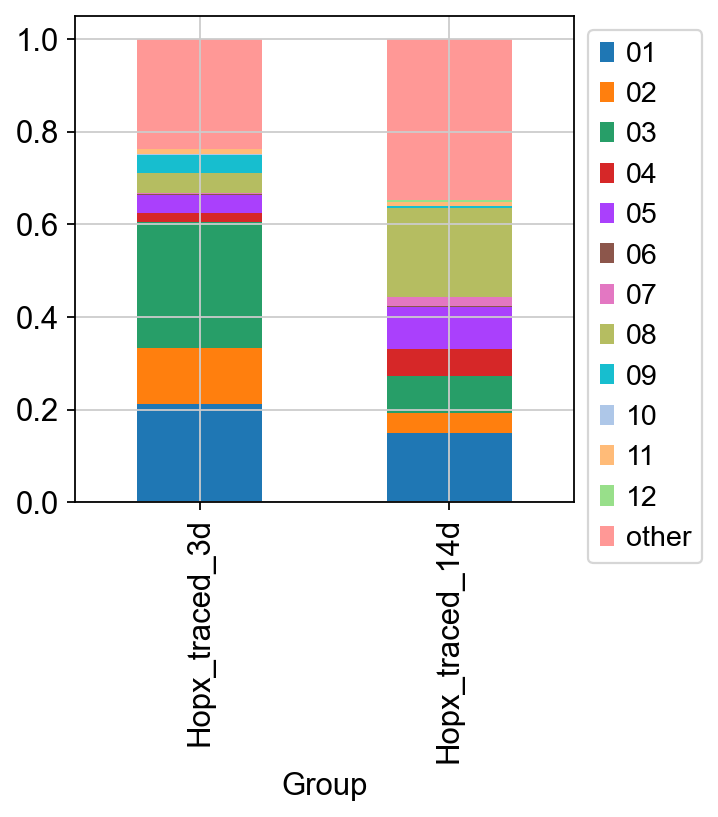

In [150]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

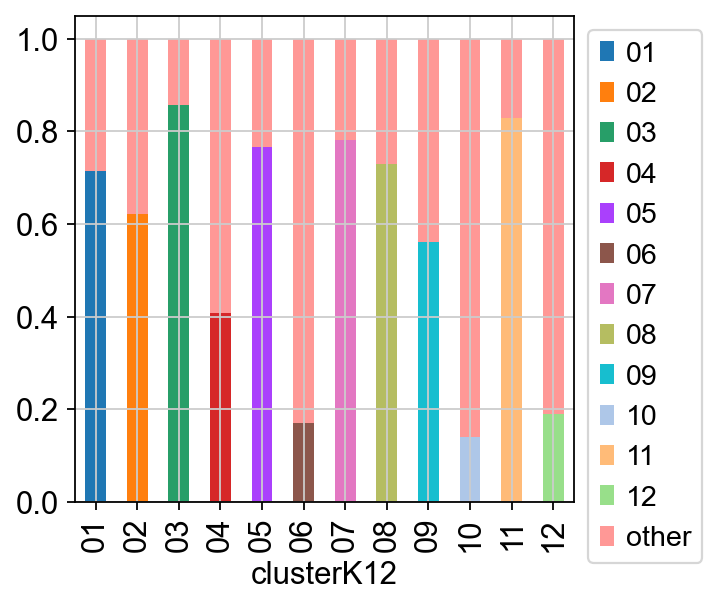

In [151]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [154]:
adata.write_h5ad(results_file)

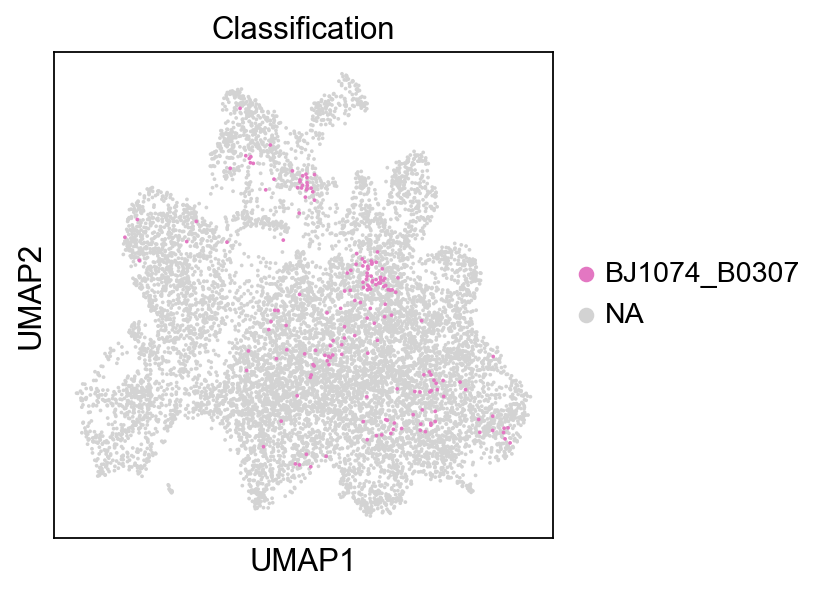

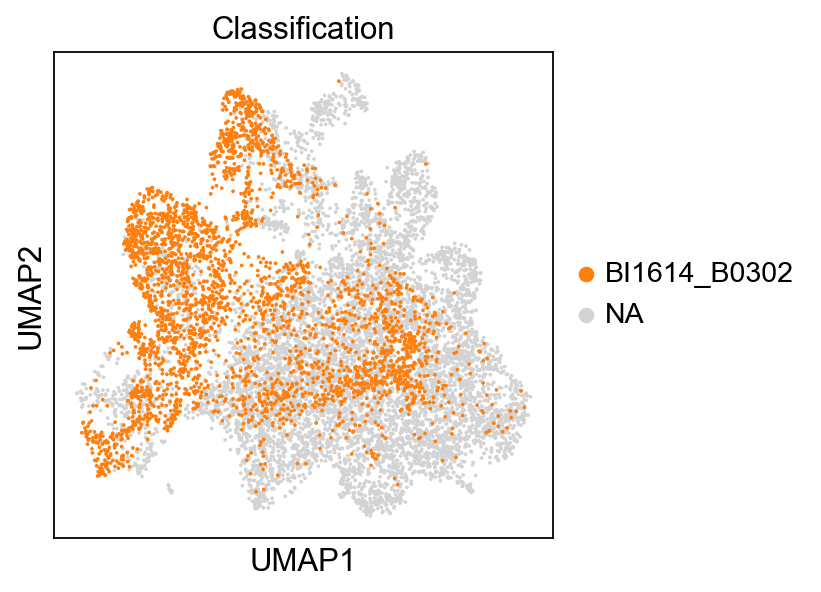

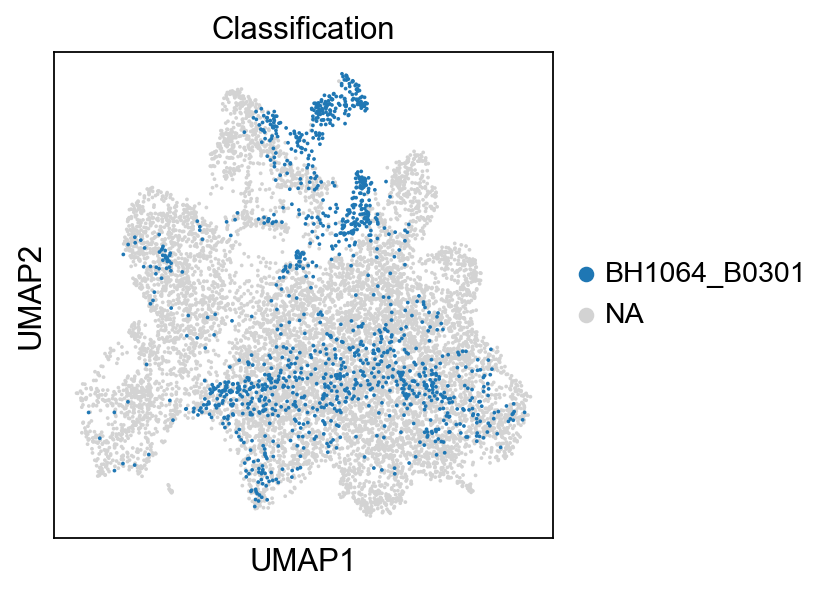

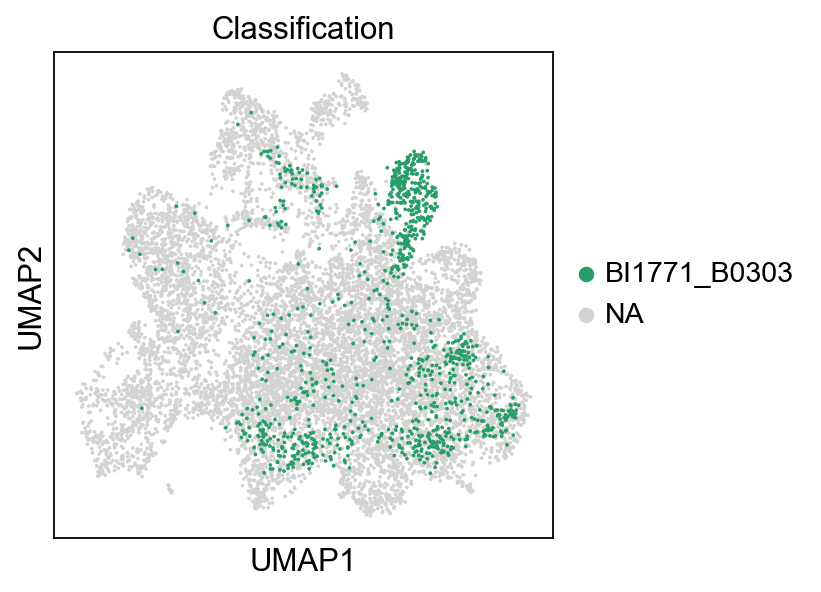

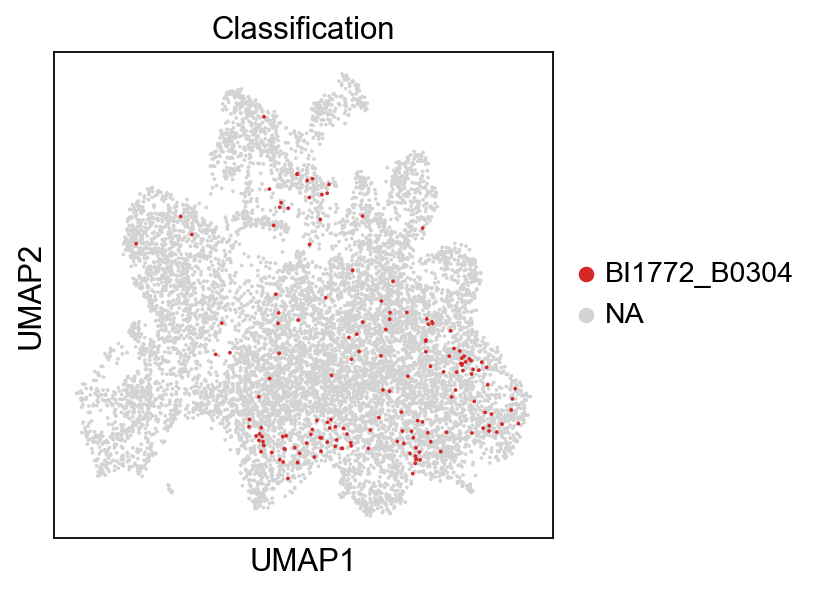

...

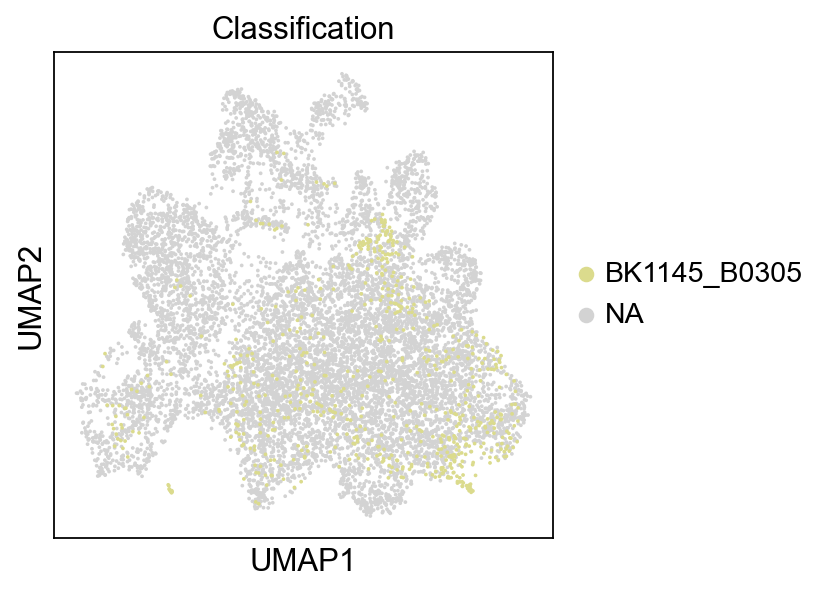

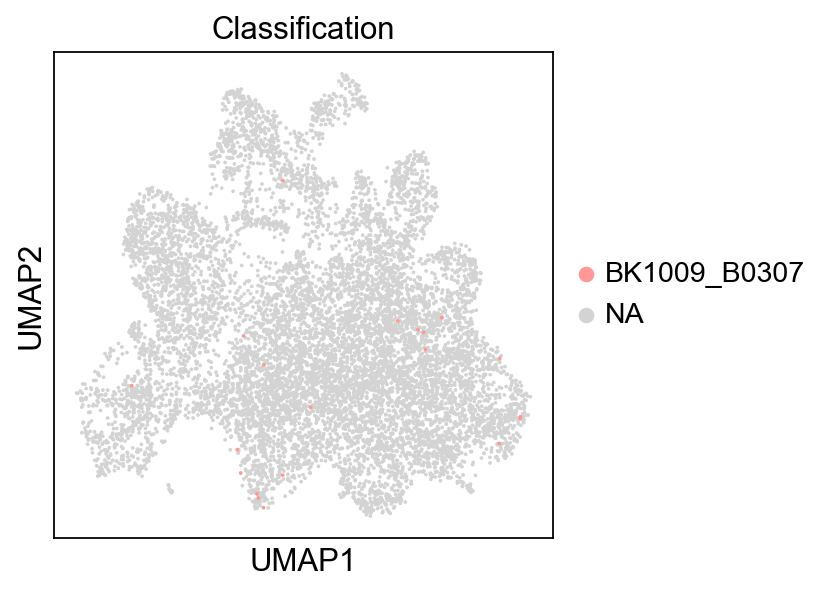

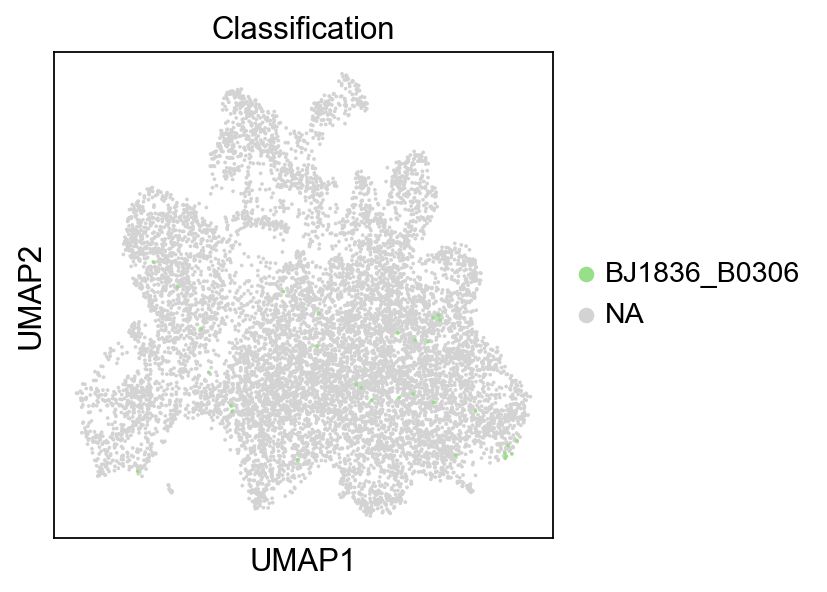

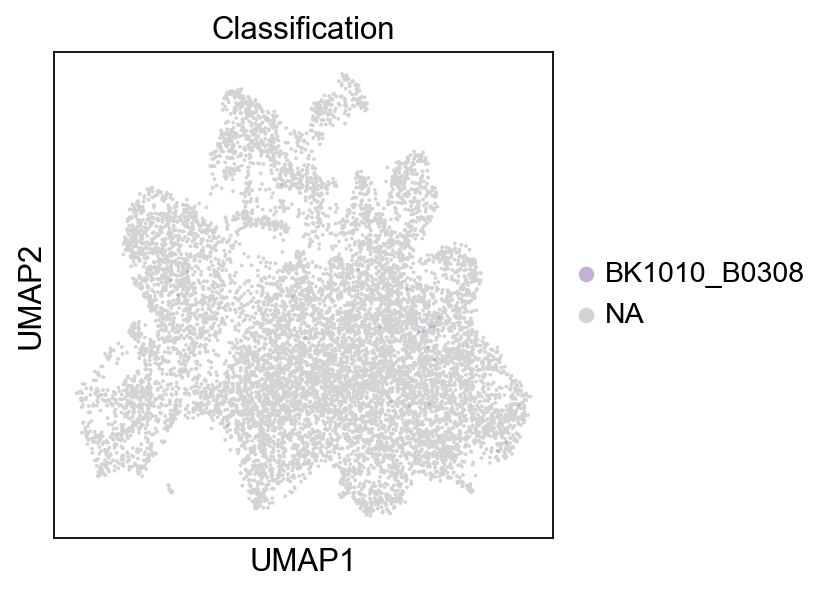

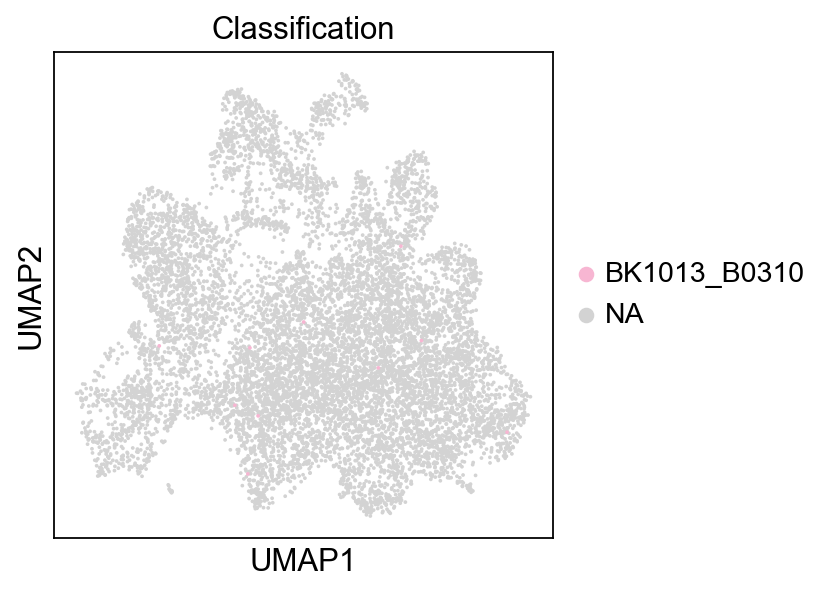

In [112]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [113]:
sc.tl.embedding_density(adata,basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


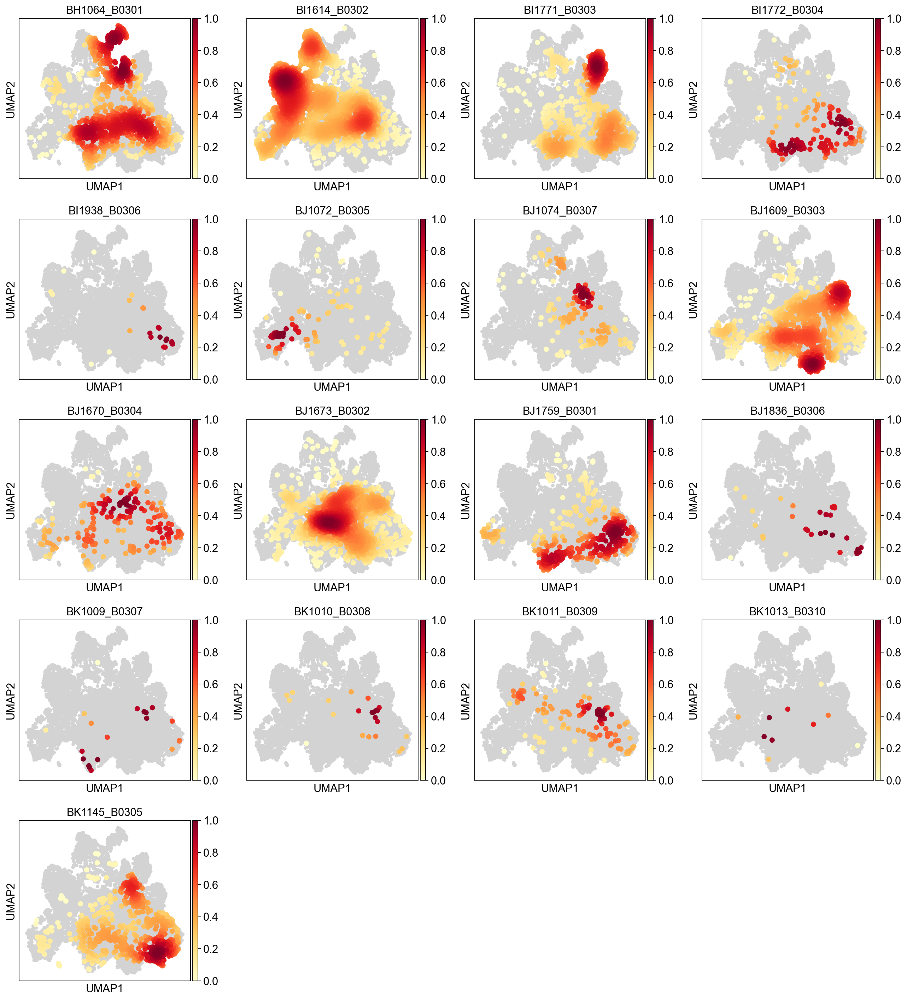

In [114]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Classification', )

## Examine differentially expressed genes

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:34)


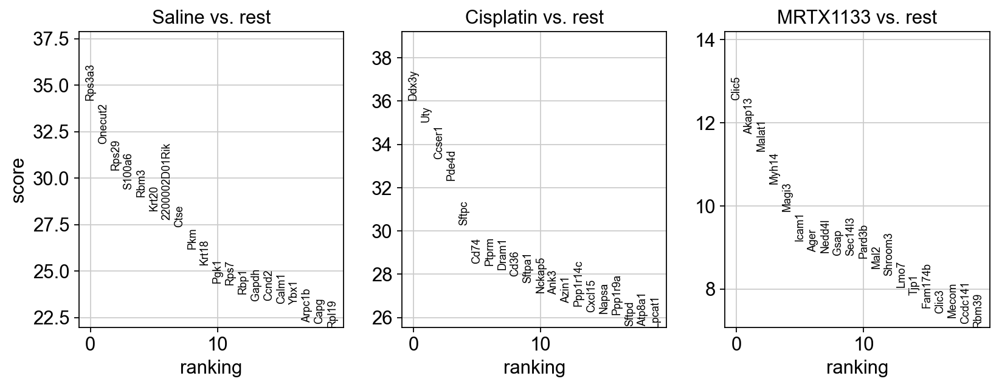

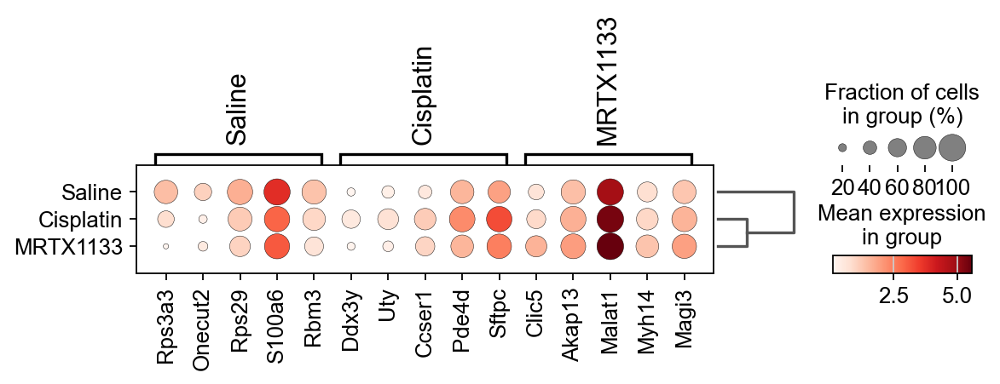

In [116]:
sc.tl.rank_genes_groups(adata, 'Group', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="Group")

In [117]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores','logfoldchanges']})
results_df.to_excel('figures/all_v_all_enriched_genes.xlsx')
results_df

,Saline_n,Saline_p,Saline_s,Saline_l,Cisplatin_n,Cisplatin_p,Cisplatin_s,Cisplatin_l,MRTX1133_n,MRTX1133_p,MRTX1133_s,MRTX1133_l
0,Rps3a3,2.366044e-252,34.209419,1.447255,Ddx3y,2.898673e-280,36.056957,2.055338,Clic5,1.749816e-32,12.551794,1.795816
1,Onecut2,9.345803e-219,31.841434,2.205050,Uty,9.666362e-265,35.032688,1.577305,Akap13,2.089249e-28,11.731797,0.831624
2,Rps29,7.830396e-200,30.432711,0.933103,Ccser1,1.395567e-239,33.327377,1.582465,Malat1,2.074144e-26,11.324007,0.740813
3,S100a6,1.272440e-186,29.408796,1.288305,Pde4d,8.836135e-226,32.351814,1.151372,Myh14,7.265691e-23,10.523629,0.985485
4,Rbm3,2.531092e-181,28.984543,0.880061,Sftpc,1.371385e-197,30.273787,2.085814,Magi3,3.982232e-20,9.862650,0.939723
...,...,...,...,...,...,...,...,...,...,...,...,...
27012,Pde4d,1.470267e-191,-29.796368,-1.039088,2200002D01Rik,2.556914e-146,-26.033255,-1.005974,Rpl12,5.296968e-35,-13.016932,-1.111345
27013,Sftpc,1.483307e-202,-30.642817,-2.025328,Rps29,2.537047e-157,-26.999390,-0.837480,Fam213a,2.897569e-37,-13.425445,-1.310713
27014,Uty,6.538890e-223,-32.147148,-1.472967,Krt20,1.876914e-161,-27.356525,-2.618882,Rbm3,1.341199e-41,-14.165909,-1.250752
27015,Ddx3y,4.398072e-242,-33.499607,-1.967336,S100a6,4.418227e-164,-27.579462,-1.253390,Tpt1,1.209830e-47,-15.139004,-0.951352


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:53)


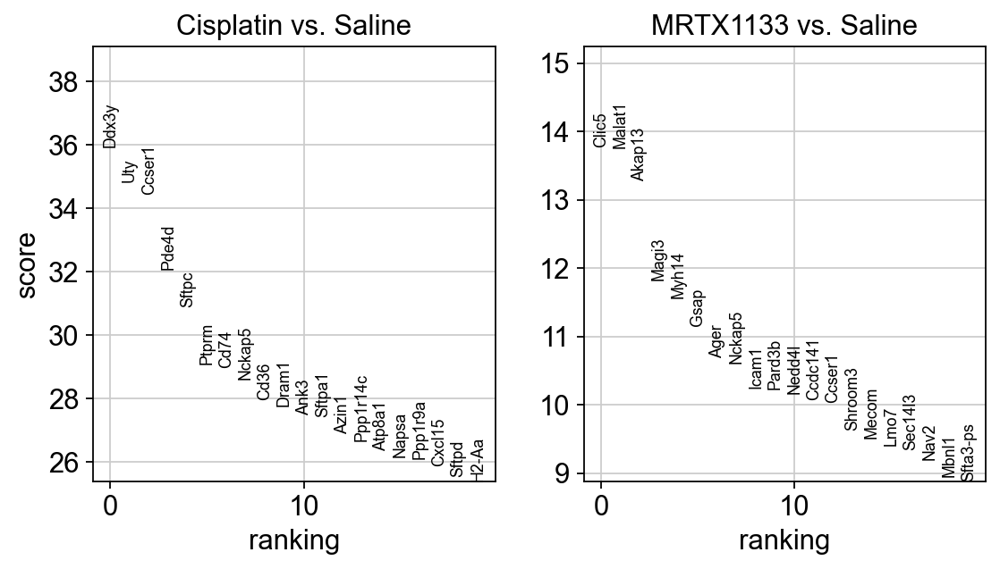

categories: Saline, Cisplatin, MRTX1133
var_group_labels: Cisplatin, MRTX1133


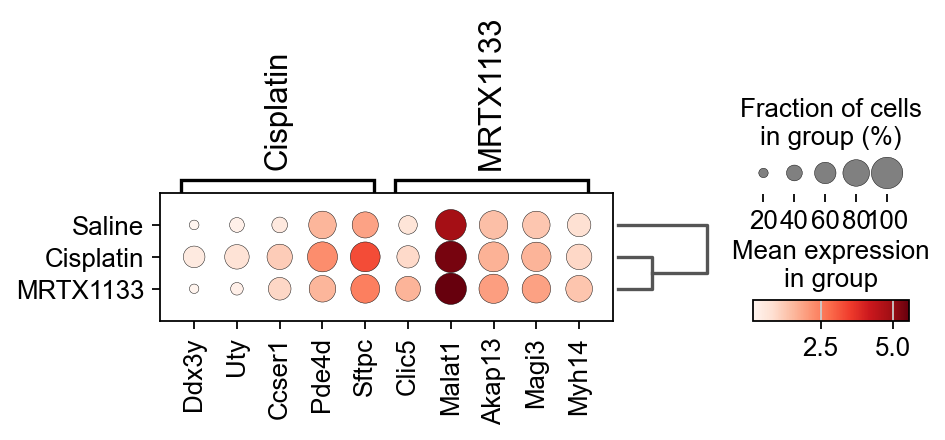

In [118]:
sc.tl.rank_genes_groups(adata, 'Group', reference='Saline', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="Group")

In [119]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores','logfoldchanges']})
results_df.to_excel('figures/Saline_v_all_enriched_genes.xlsx')
results_df

,Cisplatin_n,Cisplatin_p,Cisplatin_s,Cisplatin_l,MRTX1133_n,MRTX1133_p,MRTX1133_s,MRTX1133_l
0,Ddx3y,2.637722e-278,35.931736,2.086087,Clic5,1.402415e-39,13.774405,2.039979
1,Uty,1.603243e-261,34.820595,1.586994,Malat1,1.516944e-39,13.759084,1.004156
2,Ccser1,8.098049e-256,34.429935,1.675781,Akap13,9.867643e-37,13.265854,0.995227
3,Pde4d,6.680549e-222,32.074844,1.150981,Magi3,3.644768e-29,11.823027,1.162940
4,Sftpc,1.035327e-205,30.878820,2.144265,Myh14,7.255243e-28,11.554786,1.125148
...,...,...,...,...,...,...,...,...
27012,Krt20,1.748171e-172,-28.268589,-2.677367,Fam213a,4.634272e-43,-14.365033,-1.422254
27013,S100a6,1.164482e-177,-28.692436,-1.315129,Rpl12,9.330041e-47,-14.957990,-1.296139
27014,Rps29,2.273372e-181,-28.995155,-0.902913,Tpt1,2.290316e-54,-16.100191,-1.024364
27015,Rps3a3,3.634800e-188,-29.537811,-1.259526,Rbm3,3.142418e-62,-17.207664,-1.526428


## Figures for the paper

In [115]:
adata.obs['HPCS_state'] = ['HPCS' if x == 'HPCS' else "other" for x in adata.obs['cell type']]

In [116]:
import scipy.stats
def calculateMedianStats(gene, group='HPCS_state',value='HPCS'):
    print("Gene:",gene," Group:",group)
    print("Means: In",group,np.mean(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]),
         "Out",group,np.mean(adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    print("Medians: In",group,np.median(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]),
         "Out",group,np.median(adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    print(gene,scipy.stats.mannwhitneyu(adata[adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0], 
                         adata[~adata.obs[group].isin([value]),adata.var.index.isin([gene])].X[:,0]))
    

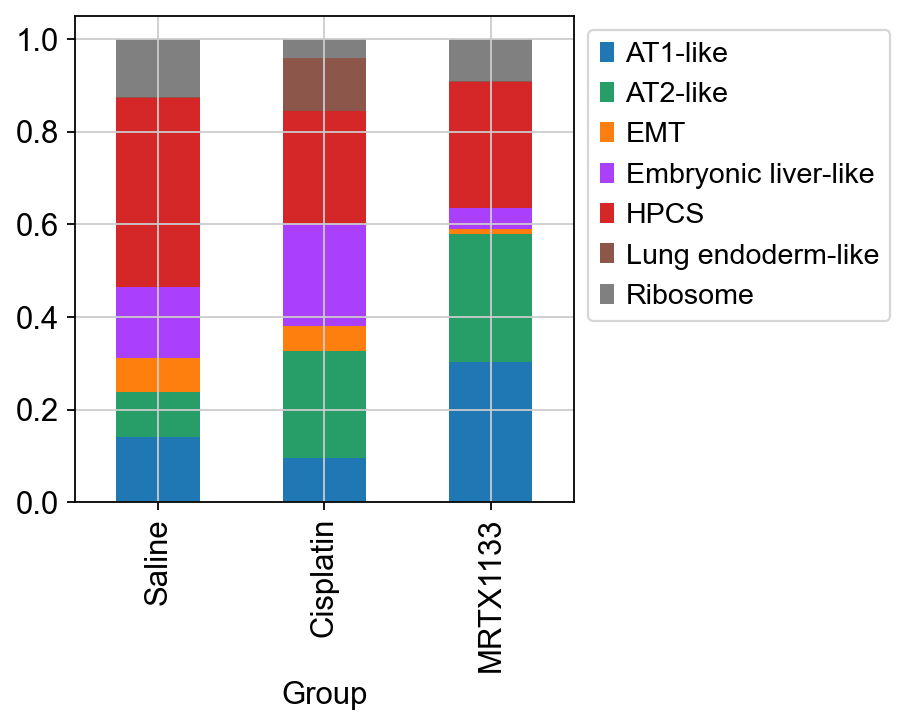

In [117]:
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True, color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Fig4d_drugproportions.svg')

## Calculate Phenotypic Volume

# Write final h5ad

In [124]:
adata.write_h5ad(results_file,compression='gzip')